<a href="https://colab.research.google.com/github/ndb796/Decision-based-Attacks-PyTorch/blob/main/Targeted_HopSkipJump_Attack_for_CelebA_Identity_Classification_Using_PyTorch_Foolbox_with_Determined_Targets_(Correctly_Classified_Dataset).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### <b>Dataset Download</b>

<pre>
<b>Dataset/</b>
    <b>test/</b>
        identity 1/
        identity 2/
        ...
</pre>

In [ ]:
%%capture
!wget https://postechackr-my.sharepoint.com/:u:/g/personal/dongbinna_postech_ac_kr/EW5XzDm1pNVIgsoADwSmclsBS_FXWMA82NlL_0YiRTVeMg?download=1 -O determined_corrected_facial_identity_latent_vectors.zip
!unzip determined_corrected_facial_identity_latent_vectors.zip -d ./determined_corrected_facial_identity_latent_vectors

### <b>Load Dataset</b>

* Set the image directory path and initialize PyTorch data loaders.

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim

import torchvision
from torchvision import datasets, models, transforms

import numpy as np
import matplotlib.pyplot as plt

import time
import os


device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu") # device object

In [ ]:
# ref: https://chsasank.github.io/vision/_modules/torchvision/datasets/folder.html
from PIL import Image
import os
import os.path
from torch.utils.data import Dataset


def is_png_file(filename):
    return any(filename.endswith(extension) for extension in ['.png'])


def find_classes(dir):
    classes = [d for d in os.listdir(dir) if os.path.isdir(os.path.join(dir, d))]
    classes.sort()
    global class_to_idx
    class_to_idx = {classes[i]: i for i in range(len(classes))}
    return classes, class_to_idx


def make_dataset(dir, class_to_idx):
    processed = set()
    images = []
    dir = os.path.expanduser(dir)
    for target in sorted(os.listdir(dir)):
        d = os.path.join(dir, target)
        if not os.path.isdir(d):
            continue

        for root, _, fnames in sorted(os.walk(d)):
            for fname in sorted(fnames):
                if is_png_file(fname):
                    path = os.path.join(root, fname).split('.png')[0][:-4]
                    temp = os.listdir(path.split('img')[0])
                    for di in temp:
                        if 'trg_' in di and 'img' + path.split('img')[1] in di:
                            target_label = di.split('trg_')[1].split('.npy')[0]
                    if path in processed:
                        continue
                    processed.add(path)
                    item = (path + '.ori.png', path + '.ori.npy', class_to_idx[target], path + '.trg.png', path + f'.trg_{target_label}.npy', class_to_idx[target_label])
                    images.append(item)

    return images


def numpy_loader(path):
    return np.load(path)


def pil_loader(path):
    with open(path, 'rb') as f:
        with Image.open(f) as img:
            return img.convert('RGB')


class LatentFolder(Dataset):
    def __init__(self, root, target_transforms):
        classes, class_to_idx = find_classes(root)
        imgs = make_dataset(root, class_to_idx)

        self.root = root
        self.imgs = imgs
        self.classes = classes
        self.class_to_idx = class_to_idx
        self.numpy_loader = numpy_loader
        self.pil_loader = pil_loader
        self.target_transforms = target_transforms

    def __getitem__(self, index):
        img, npy, label, trg_img, trg_npy, target_label = self.imgs[index]
        img = self.pil_loader(img)
        img = self.target_transforms(img)
        trg_img = self.pil_loader(trg_img)
        trg_img = self.target_transforms(trg_img)
        npy = self.numpy_loader(npy)
        npy = torch.from_numpy(npy)
        trg_npy = self.numpy_loader(trg_npy)
        trg_npy = torch.from_numpy(trg_npy)
        return img, npy, label, trg_img, trg_npy, target_label

    def __len__(self):
        return len(self.imgs)

In [ ]:
transforms_test = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor()
])

data_dir = './determined_corrected_facial_identity_latent_vectors/determined_corrected_facial_identity_latent_vectors'

test_dataset = LatentFolder(os.path.join(data_dir), transforms_test)
test_dataloader = torch.utils.data.DataLoader(test_dataset, batch_size=8, shuffle=False, num_workers=2)
print('Test dataset size:', len(test_dataset))

class_names = test_dataset.classes
print('Class names:', class_names)

Test dataset size: 191
Class names: ['102', '1027', '103', '104', '1041', '1043', '1044', '1047', '1052', '1060', '1077', '1079', '108', '1081', '1087', '1090', '1093', '1109', '111', '1112', '112', '1120', '1126', '1133', '1140', '1145', '1149', '1157', '1158', '116', '1191', '121', '1210', '122', '1220', '1237', '124', '125', '1256', '1262', '1268', '1269', '128', '1280', '1285', '129', '1291', '1293', '1307', '1317', '1330', '1335', '1350', '1351', '1370', '1396', '14', '1407', '1427', '1429', '143', '1435', '1440', '1452', '146', '1507', '1515', '1521', '1531', '1538', '1550', '158', '1581', '1584', '1595', '161', '162', '17', '1718', '1730', '175', '177', '1775', '1781', '179', '1796', '180', '1800', '181', '182', '1823', '183', '1837', '1838', '1848', '188', '1904', '1930', '194', '195', '196', '1965', '1972', '1974', '198', '1989', '199', '2020', '203', '2037', '204', '205', '206', '2076', '208', '2116', '2120', '213', '2131', '218', '2193', '2214', '223', '226', '228', '230', '

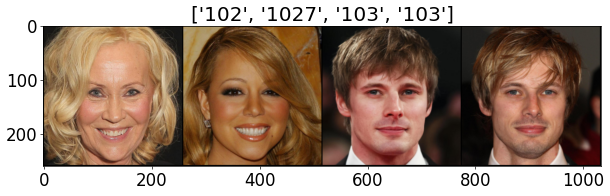

In [ ]:
plt.rcParams['figure.figsize'] = [12, 8]
plt.rcParams['figure.dpi'] = 60
plt.rcParams.update({'font.size': 20})


def imshow(input, title):
    # torch.Tensor => numpy
    input = input.numpy().transpose((1, 2, 0))
    # display images
    plt.imshow(input)
    plt.title(title)
    plt.show()


# load a batch of train image
iterator = iter(test_dataloader)

# visualize a batch of train image
inputs, npys, classes, _, _, _ = next(iterator)
out = torchvision.utils.make_grid(inputs[:4])
imshow(out, title=[class_names[x] for x in classes[:4]])

### <b>Load Pre-trained Model</b>

In [ ]:
!wget https://postechackr-my.sharepoint.com/:u:/g/personal/dongbinna_postech_ac_kr/EeIlxtZtQIdFhRCUkCBSaIQBBbP5dujTUpRNtj8TRinRaQ?download=1 -O facial_identity_classification_transfer_learning_with_ResNet18_resolution_256.pth

--2021-03-18 22:11:54--  https://postechackr-my.sharepoint.com/:u:/g/personal/dongbinna_postech_ac_kr/EeIlxtZtQIdFhRCUkCBSaIQBBbP5dujTUpRNtj8TRinRaQ?download=1
Resolving postechackr-my.sharepoint.com (postechackr-my.sharepoint.com)... 13.107.136.9
Connecting to postechackr-my.sharepoint.com (postechackr-my.sharepoint.com)|13.107.136.9|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: /personal/dongbinna_postech_ac_kr/Documents/Research/models/CelebA%20HQ/facial_identity_classification_transfer_learning_with_ResNet18_resolution_256.pth?originalPath=aHR0cHM6Ly9wb3N0ZWNoYWNrci1teS5zaGFyZXBvaW50LmNvbS86dTovZy9wZXJzb25hbC9kb25nYmlubmFfcG9zdGVjaF9hY19rci9FZUlseHRadFFJZEZoUkNVa0NCU2FJUUJCYlA1ZHVqVFVwUk50ajhUUmluUmFRP3J0aW1lPVhmTWYxMXJxMkVn [following]
--2021-03-18 22:11:55--  https://postechackr-my.sharepoint.com/personal/dongbinna_postech_ac_kr/Documents/Research/models/CelebA%20HQ/facial_identity_classification_transfer_learning_with_ResNet18_resolution_256.pth?

In [ ]:
save_path = 'facial_identity_classification_transfer_learning_with_ResNet18_resolution_256.pth'

model = models.resnet18(pretrained=True)
num_features = model.fc.in_features
model.fc = nn.Linear(num_features, 307) # multi-class classification (num_of_class == 307)
model.load_state_dict(torch.load(save_path))
model.to(device)

Downloading: "https://download.pytorch.org/models/resnet18-5c106cde.pth" to /root/.cache/torch/hub/checkpoints/resnet18-5c106cde.pth


ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

In [ ]:
# input data normalization class
class Normalize(nn.Module) :
    def __init__(self, mean, std) :
        super(Normalize, self).__init__()
        self.register_buffer('mean', torch.Tensor(mean))
        self.register_buffer('std', torch.Tensor(std))
        
    def forward(self, input):
        mean = self.mean.reshape(1, 3, 1, 1)
        std = self.std.reshape(1, 3, 1, 1)
        return (input - mean) / std

In [ ]:
model = nn.Sequential(
    Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]), # add an input normalization layer
    model
).to(device).eval()

### <b>Test Phase</b>

[Prediction Result Examples]


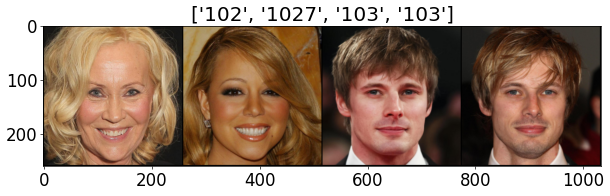

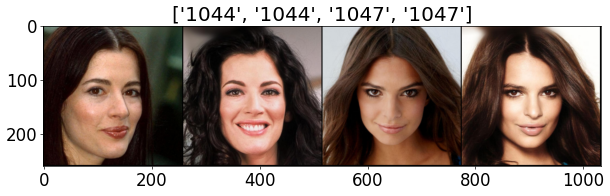

[Test] Loss: 0.0236 Acc: 100.0000% Time: 2.0961s


In [ ]:
criterion = nn.CrossEntropyLoss()

model.eval()
start_time = time.time()

with torch.no_grad():
    running_loss = 0.
    running_corrects = 0

    for i, (inputs, npys, labels, target_inputs, target_npys, target_labels) in enumerate(test_dataloader):
        inputs = inputs.to(device)
        labels = labels.to(device)

        outputs = model(inputs)
        _, preds = torch.max(outputs, 1)
        loss = criterion(outputs, labels)

        running_loss += loss.item() * inputs.size(0)
        running_corrects += torch.sum(preds == labels.data)

        if i == 0:
            print('[Prediction Result Examples]')
            images = torchvision.utils.make_grid(inputs[:4])
            imshow(images.cpu(), title=[class_names[x] for x in labels[:4]])
            images = torchvision.utils.make_grid(inputs[4:8])
            imshow(images.cpu(), title=[class_names[x] for x in labels[4:8]])

    epoch_loss = running_loss / len(test_dataset)
    epoch_acc = running_corrects / len(test_dataset) * 100.
    print('[Test] Loss: {:.4f} Acc: {:.4f}% Time: {:.4f}s'.format(epoch_loss, epoch_acc, time.time() - start_time))

[Prediction Result Examples]


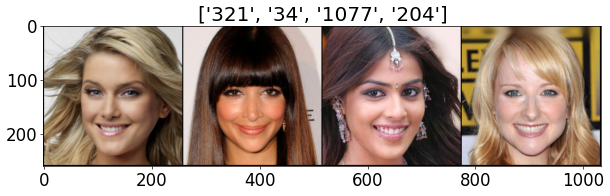

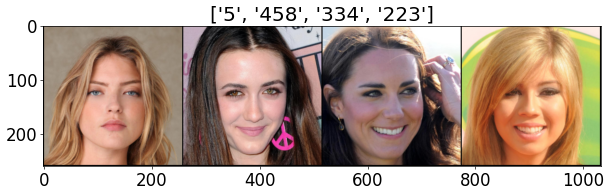

[Test] Loss: 0.0173 Acc: 100.0000% Time: 1.9560s


In [ ]:
criterion = nn.CrossEntropyLoss()

model.eval()
start_time = time.time()

with torch.no_grad():
    running_loss = 0.
    running_corrects = 0

    for i, (inputs, npys, labels, target_inputs, target_npys, target_labels) in enumerate(test_dataloader):
        target_inputs = target_inputs.to(device)
        target_labels = target_labels.to(device)

        outputs = model(target_inputs)
        _, preds = torch.max(outputs, 1)
        loss = criterion(outputs, target_labels)

        running_loss += loss.item() * target_inputs.size(0)
        running_corrects += torch.sum(preds == target_labels.data)

        if i == 0:
            print('[Prediction Result Examples]')
            images = torchvision.utils.make_grid(target_inputs[:4])
            imshow(images.cpu(), title=[class_names[x] for x in target_labels[:4]])
            images = torchvision.utils.make_grid(target_inputs[4:8])
            imshow(images.cpu(), title=[class_names[x] for x in target_labels[4:8]])

    epoch_loss = running_loss / len(test_dataset)
    epoch_acc = running_corrects / len(test_dataset) * 100.
    print('[Test] Loss: {:.4f} Acc: {:.4f}% Time: {:.4f}s'.format(epoch_loss, epoch_acc, time.time() - start_time))

#### <b>Prepare Adversarial Attack Libraries</b>

In [ ]:
!pip install eagerpy
!pip install gitpython

In [ ]:
!git clone https://github.com/ndb796/Foolbox-Decision-based-Attack-Baseline
!cp -r ./Foolbox-Decision-based-Attack-Baseline/* ./

Cloning into 'Foolbox-Decision-based-Attack-Baseline'...
remote: Enumerating objects: 280, done.
remote: Counting objects: 100% (280/280), done.
remote: Compressing objects: 100% (266/266), done.
remote: Total 280 (delta 25), reused 246 (delta 7), pack-reused 0
Receiving objects: 100% (280/280), 8.50 MiB | 31.42 MiB/s, done.
Resolving deltas: 100% (25/25), done.


In [ ]:
def get_distance(a, b):
    l0 = torch.norm((a - b).view(a.shape[0], -1), p=0, dim=1)
    l2 = torch.norm((a - b).view(a.shape[0], -1), p=2, dim=1)
    mse = (a - b).view(a.shape[0], -1).pow(2).mean(1)
    linf = torch.norm((a - b).view(a.shape[0], -1), p=float('inf'), dim=1)
    return l0, l2, mse, linf

In [ ]:
# reproducible source code
import random

random.seed(0)
np.random.seed(0)
torch.manual_seed(0)

%load_ext autoreload
%autoreload 2

#### <b>Adversarial Attack Example 1</b>

* <b>Attack method</b>: HopSkipJump Attack
* <b>Images</b>: All test images

[Attack start for one batch]
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.5689, 0.4927, 0.4025, 0.5749, 0.6959, 0.5979, 0.6609, 0.7165],
                     device='cuda:0'))
Binary step count: 27
Gradient step count: 100
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.8834, 0.9661, 0.9549, 0.9557, 0.8678, 0.9466, 0.9007, 0.9723],
                     device='cuda:0'))
Binary step count: 26
Gradient step count: 141
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.8462, 0.9794, 0.9424, 0.9827, 0.9088, 0.8632, 0.9130, 0.9925],
                     device='cuda:0'))
Binary step count: 26
Gradient step count: 173
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.9413, 0.9636, 0.9552, 0.9890, 0.9674, 0.9306, 0.8289, 0.9667],
                     device='cuda:0'))
Binary step count: 26
[Attack finished] (query count: 328 

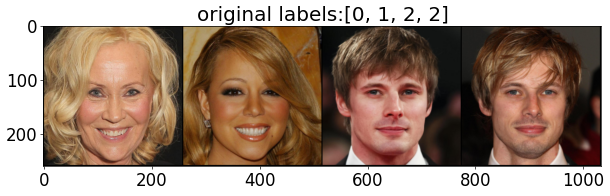

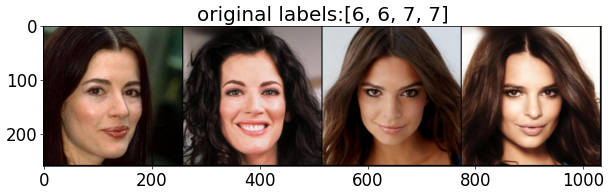

[Start Image Examples]


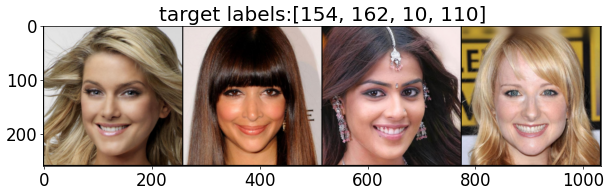

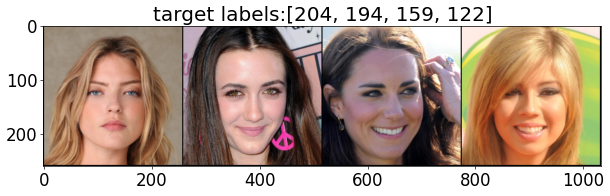

[Attack Result Examples]


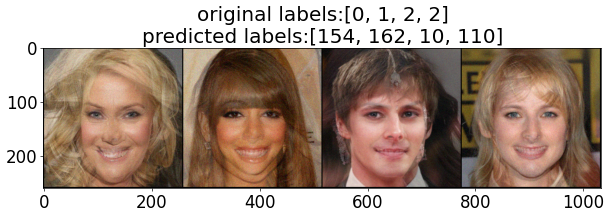

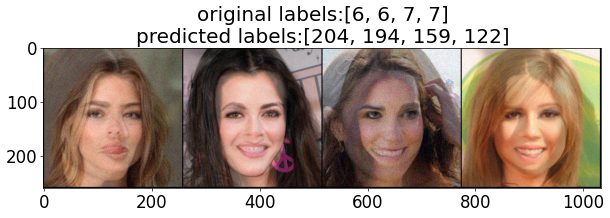

[Step #0] Loss: 0.6812 Accuracy: 0.0000% Attack success rate: 100.0000% Time elapsed: 7.5611s (total 8 images)
[Size of Perturbation]
Average L0 distance (the number of changed parameters): 196552.625
Average L2 distance: 76.1011734008789
Average MSE (from Start): 0.02629861608147621
Average MSE: 0.032231032848358154
Average Linf distance (the maximum changed values): 0.5668685436248779
[Attack start for one batch]
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.4551, 0.6575, 0.7308, 0.6161, 0.4631, 0.6088, 0.5074, 0.7934],
                     device='cuda:0'))
Binary step count: 27
Gradient step count: 100
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.8459, 0.9617, 0.9621, 0.9323, 0.9824, 0.9955, 0.9525, 0.9710],
                     device='cuda:0'))
Binary step count: 26
Gradient step count: 141
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.8585, 0.86

In [ ]:
%autoreload 2

import time
from foolbox import criteria
import foolbox as fb

criterion = nn.CrossEntropyLoss()
model.eval()
start_time = time.time()

fmodel = fb.PyTorchModel(model, bounds=(0, 1))
attack = fb.attacks.HopSkipJump(init_attack=None, steps=100,
                                # initial_gradient_eval_steps=100, max_gradient_eval_steps=10000,
                                query_limit=500)

running_loss = 0.
running_corrects = 0
running_success = 0
running_length = 0

running_l0 = 0
running_l2 = 0
running_mse = 0
running_mse_from_start = 0
running_linf = 0

for i, (inputs, npys, labels, target_inputs, target_npys, target_labels) in enumerate(test_dataloader):
    inputs = inputs.to(device)
    labels = labels.to(device)

    starting_points = target_inputs.to(device)
    target_labels = target_labels.to(device)

    attack_criterion = criteria.TargetedMisclassification(target_labels)
    _, adv_targeted, _ = attack(fmodel, inputs, criterion=attack_criterion, starting_points=starting_points, epsilons=None) # adversarial attack

    outputs = model(adv_targeted)
    _, preds = torch.max(outputs, 1)
    loss = criterion(outputs, labels)

    running_loss += loss.item()
    running_corrects += torch.sum(preds == labels.data)
    running_success += torch.sum(preds == target_labels.data)
    running_length += labels.shape[0]

    l0, l2, mse, linf = get_distance(adv_targeted, inputs)
    running_l0 += l0.sum().item()
    running_l2 += l2.sum().item()
    running_mse += mse.sum().item()
    running_mse_from_start += (adv_targeted - starting_points).view(adv_targeted.shape[0], -1).pow(2).mean(1).sum().item()
    running_linf += linf.sum().item()

    if i == 0:
        print('The dimension of an image tensor:', inputs.shape[1:])
        print('[Original Image Examples]')
        images = torchvision.utils.make_grid(inputs[:4])
        imshow(images.cpu(), title='original labels:' + str([int(x) for x in labels[:4]]))
        images = torchvision.utils.make_grid(inputs[4:8])
        imshow(images.cpu(), title='original labels:' + str([int(x) for x in labels[4:8]]))
        print('[Start Image Examples]')
        images = torchvision.utils.make_grid(starting_points[:4])
        imshow(images.cpu(), title='target labels:' + str([int(x) for x in target_labels[:4]]))
        images = torchvision.utils.make_grid(starting_points[4:8])
        imshow(images.cpu(), title='target labels:' + str([int(x) for x in target_labels[4:8]]))
        print('[Attack Result Examples]')
        images = torchvision.utils.make_grid(adv_targeted[:4])
        imshow(images.cpu(), title='original labels:' + str([int(x) for x in labels[:4]]) +
               '\npredicted labels:' + str([int(x) for x in preds[:4]]))
        images = torchvision.utils.make_grid(adv_targeted[4:8])
        imshow(images.cpu(), title='original labels:' + str([int(x) for x in labels[4:8]]) +
               '\npredicted labels:' + str([int(x) for x in preds[4:8]]))

    cur_running_loss = running_loss / running_length
    running_acc = running_corrects / running_length * 100.
    running_asr = running_success / running_length * 100.
    print('[Step #{}] Loss: {:.4f} Accuracy: {:.4f}% Attack success rate: {:.4f}% Time elapsed: {:.4f}s (total {} images)'.format(i, cur_running_loss, running_acc, running_asr, time.time() - start_time, running_length))

    print('[Size of Perturbation]')
    print('Average L0 distance (the number of changed parameters):', running_l0 / running_length)
    print('Average L2 distance:', running_l2 / running_length)
    print('Average MSE (from Start):', running_mse_from_start / running_length)
    print('Average MSE:', running_mse / running_length)
    print('Average Linf distance (the maximum changed values):', running_linf / running_length)

epoch_loss = running_loss / running_length
epoch_acc = running_corrects / running_length * 100.
epoch_asr = running_success / running_length * 100.
print('[Validation] Loss: {:.4f} Accuracy: {:.4f}% Attack success rate: {:.4f}% Time elapsed: {:.4f}s (total {} images)'.format(epoch_loss, epoch_acc, epoch_asr, time.time() - start_time, running_length))

print('[Size of Perturbation]')
print('Average L0 distance (the number of changed parameters):', running_l0 / running_length)
print('Average L2 distance:', running_l2 / running_length)
print('Average MSE (from Start):', running_mse_from_start / running_length)
print('Average MSE:', running_mse / running_length)
print('Average Linf distance (the maximum changed values):', running_linf / running_length)

#### <b>Adversarial Attack Example 2</b>

* <b>Attack method</b>: HopSkipJump Attack
* <b>Images</b>: All test images

[Attack start for one batch]
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.5689, 0.4927, 0.4025, 0.5749, 0.6959, 0.5979, 0.6609, 0.7165],
                     device='cuda:0'))
Binary step count: 27
Gradient step count: 100
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.9681, 0.9406, 0.9682, 0.9230, 0.8518, 0.9325, 0.8966, 0.9957],
                     device='cuda:0'))
Binary step count: 26
Gradient step count: 141
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.8925, 0.9116, 0.9522, 0.9584, 0.9163, 0.9140, 0.9025, 0.9540],
                     device='cuda:0'))
Binary step count: 26
Gradient step count: 173
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.9163, 0.9284, 0.9602, 0.9765, 0.8103, 0.9453, 0.8583, 0.9984],
                     device='cuda:0'))
Binary step count: 26
Gradient step count: 200
Reached num

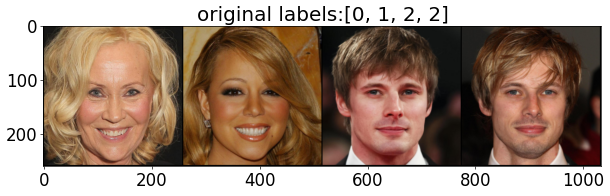

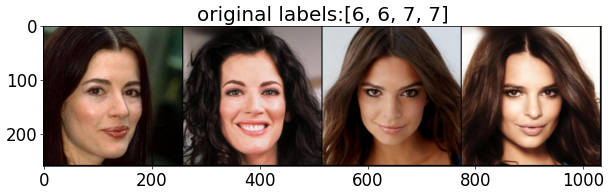

[Start Image Examples]


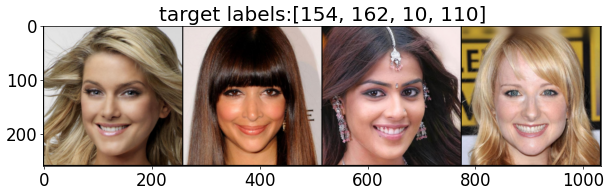

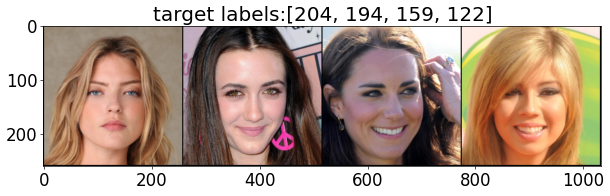

[Attack Result Examples]


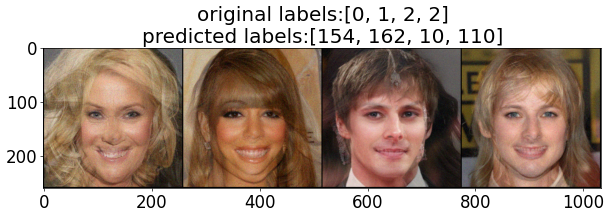

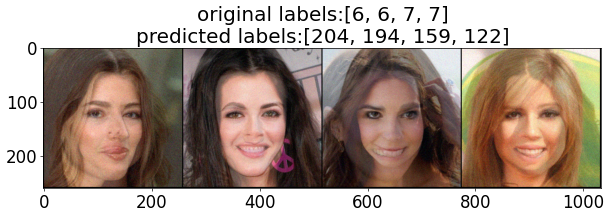

[Step #0] Loss: 0.5565 Accuracy: 0.0000% Attack success rate: 100.0000% Time elapsed: 13.8220s (total 8 images)
[Size of Perturbation]
Average L0 distance (the number of changed parameters): 196580.125
Average L2 distance: 67.1399154663086
Average MSE (from Start): 0.03328022360801697
Average MSE: 0.02545255981385708
Average Linf distance (the maximum changed values): 0.4991973340511322
[Attack start for one batch]
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.4551, 0.6575, 0.7308, 0.6161, 0.4631, 0.6088, 0.5074, 0.7934],
                     device='cuda:0'))
Binary step count: 27
Gradient step count: 100
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.7951, 0.9524, 0.9539, 0.9607, 0.9880, 0.9477, 0.9523, 0.9910],
                     device='cuda:0'))
Binary step count: 26
Gradient step count: 141
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.9502, 0.83

In [ ]:
%autoreload 2

import time
from foolbox import criteria
import foolbox as fb

criterion = nn.CrossEntropyLoss()
model.eval()
start_time = time.time()

fmodel = fb.PyTorchModel(model, bounds=(0, 1))
attack = fb.attacks.HopSkipJump(init_attack=None, steps=100,
                                # initial_gradient_eval_steps=100, max_gradient_eval_steps=10000,
                                query_limit=1000)

running_loss = 0.
running_corrects = 0
running_success = 0
running_length = 0

running_l0 = 0
running_l2 = 0
running_mse = 0
running_mse_from_start = 0
running_linf = 0

for i, (inputs, npys, labels, target_inputs, target_npys, target_labels) in enumerate(test_dataloader):
    inputs = inputs.to(device)
    labels = labels.to(device)

    starting_points = target_inputs.to(device)
    target_labels = target_labels.to(device)

    attack_criterion = criteria.TargetedMisclassification(target_labels)
    _, adv_targeted, _ = attack(fmodel, inputs, criterion=attack_criterion, starting_points=starting_points, epsilons=None) # adversarial attack

    outputs = model(adv_targeted)
    _, preds = torch.max(outputs, 1)
    loss = criterion(outputs, labels)

    running_loss += loss.item()
    running_corrects += torch.sum(preds == labels.data)
    running_success += torch.sum(preds == target_labels.data)
    running_length += labels.shape[0]

    l0, l2, mse, linf = get_distance(adv_targeted, inputs)
    running_l0 += l0.sum().item()
    running_l2 += l2.sum().item()
    running_mse += mse.sum().item()
    running_mse_from_start += (adv_targeted - starting_points).view(adv_targeted.shape[0], -1).pow(2).mean(1).sum().item()
    running_linf += linf.sum().item()

    if i == 0:
        print('The dimension of an image tensor:', inputs.shape[1:])
        print('[Original Image Examples]')
        images = torchvision.utils.make_grid(inputs[:4])
        imshow(images.cpu(), title='original labels:' + str([int(x) for x in labels[:4]]))
        images = torchvision.utils.make_grid(inputs[4:8])
        imshow(images.cpu(), title='original labels:' + str([int(x) for x in labels[4:8]]))
        print('[Start Image Examples]')
        images = torchvision.utils.make_grid(starting_points[:4])
        imshow(images.cpu(), title='target labels:' + str([int(x) for x in target_labels[:4]]))
        images = torchvision.utils.make_grid(starting_points[4:8])
        imshow(images.cpu(), title='target labels:' + str([int(x) for x in target_labels[4:8]]))
        print('[Attack Result Examples]')
        images = torchvision.utils.make_grid(adv_targeted[:4])
        imshow(images.cpu(), title='original labels:' + str([int(x) for x in labels[:4]]) +
               '\npredicted labels:' + str([int(x) for x in preds[:4]]))
        images = torchvision.utils.make_grid(adv_targeted[4:8])
        imshow(images.cpu(), title='original labels:' + str([int(x) for x in labels[4:8]]) +
               '\npredicted labels:' + str([int(x) for x in preds[4:8]]))

    cur_running_loss = running_loss / running_length
    running_acc = running_corrects / running_length * 100.
    running_asr = running_success / running_length * 100.
    print('[Step #{}] Loss: {:.4f} Accuracy: {:.4f}% Attack success rate: {:.4f}% Time elapsed: {:.4f}s (total {} images)'.format(i, cur_running_loss, running_acc, running_asr, time.time() - start_time, running_length))

    print('[Size of Perturbation]')
    print('Average L0 distance (the number of changed parameters):', running_l0 / running_length)
    print('Average L2 distance:', running_l2 / running_length)
    print('Average MSE (from Start):', running_mse_from_start / running_length)
    print('Average MSE:', running_mse / running_length)
    print('Average Linf distance (the maximum changed values):', running_linf / running_length)

epoch_loss = running_loss / running_length
epoch_acc = running_corrects / running_length * 100.
epoch_asr = running_success / running_length * 100.
print('[Validation] Loss: {:.4f} Accuracy: {:.4f}% Attack success rate: {:.4f}% Time elapsed: {:.4f}s (total {} images)'.format(epoch_loss, epoch_acc, epoch_asr, time.time() - start_time, running_length))

print('[Size of Perturbation]')
print('Average L0 distance (the number of changed parameters):', running_l0 / running_length)
print('Average L2 distance:', running_l2 / running_length)
print('Average MSE (from Start):', running_mse_from_start / running_length)
print('Average MSE:', running_mse / running_length)
print('Average Linf distance (the maximum changed values):', running_linf / running_length)

#### <b>Adversarial Attack Example 3</b>

* <b>Attack method</b>: HopSkipJump Attack
* <b>Images</b>: All test images

[Attack start for one batch]
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.5689, 0.4927, 0.4025, 0.5749, 0.6959, 0.5979, 0.6609, 0.7165],
                     device='cuda:0'))
Binary step count: 27
Gradient step count: 100
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.8775, 0.9958, 0.9645, 0.9687, 0.8909, 0.9261, 0.9882, 0.9858],
                     device='cuda:0'))
Binary step count: 26
Gradient step count: 141
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.9784, 0.8976, 0.9481, 0.9694, 0.9139, 0.9997, 0.9584, 0.9660],
                     device='cuda:0'))
Binary step count: 26
Gradient step count: 173
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.8210, 0.9596, 0.9488, 0.9617, 0.9699, 0.9555, 0.8054, 0.9973],
                     device='cuda:0'))
Binary step count: 26
Gradient step count: 200
Reached num

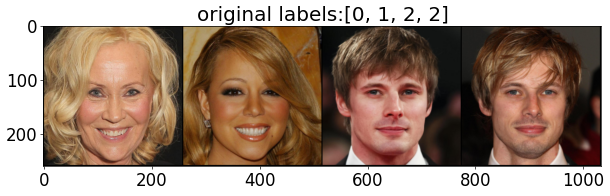

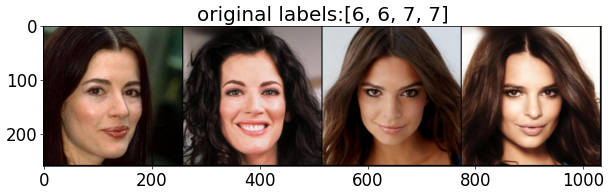

[Start Image Examples]


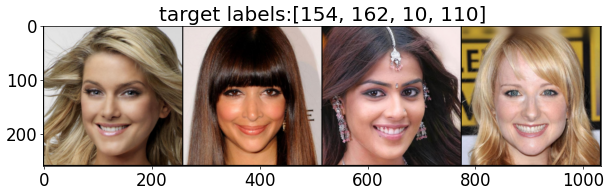

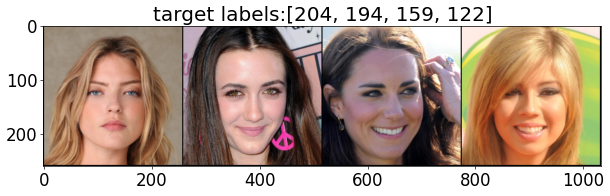

[Attack Result Examples]


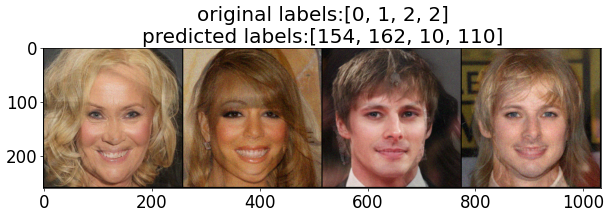

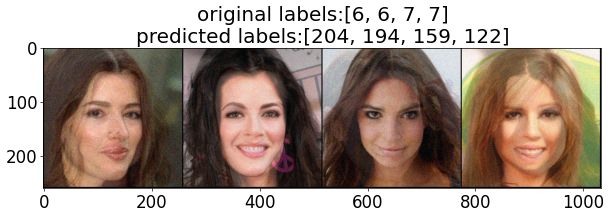

[Step #0] Loss: 0.4692 Accuracy: 0.0000% Attack success rate: 100.0000% Time elapsed: 28.7274s (total 8 images)
[Size of Perturbation]
Average L0 distance (the number of changed parameters): 196562.375
Average L2 distance: 53.973793029785156
Average MSE (from Start): 0.04615408927202225
Average MSE: 0.01744946464896202
Average Linf distance (the maximum changed values): 0.4335150718688965
[Attack start for one batch]
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.4551, 0.6575, 0.7308, 0.6161, 0.4631, 0.6088, 0.5074, 0.7934],
                     device='cuda:0'))
Binary step count: 27
Gradient step count: 100
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.9354, 0.8132, 0.9805, 0.8923, 0.9535, 0.9204, 0.9799, 0.9668],
                     device='cuda:0'))
Binary step count: 26
Gradient step count: 141
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.7902, 0.

In [ ]:
%autoreload 2

import time
from foolbox import criteria
import foolbox as fb

criterion = nn.CrossEntropyLoss()
model.eval()
start_time = time.time()

fmodel = fb.PyTorchModel(model, bounds=(0, 1))
attack = fb.attacks.HopSkipJump(init_attack=None, steps=100,
                                # initial_gradient_eval_steps=100, max_gradient_eval_steps=10000,
                                query_limit=2000)

running_loss = 0.
running_corrects = 0
running_success = 0
running_length = 0

running_l0 = 0
running_l2 = 0
running_mse = 0
running_mse_from_start = 0
running_linf = 0

for i, (inputs, npys, labels, target_inputs, target_npys, target_labels) in enumerate(test_dataloader):
    inputs = inputs.to(device)
    labels = labels.to(device)

    starting_points = target_inputs.to(device)
    target_labels = target_labels.to(device)

    attack_criterion = criteria.TargetedMisclassification(target_labels)
    _, adv_targeted, _ = attack(fmodel, inputs, criterion=attack_criterion, starting_points=starting_points, epsilons=None) # adversarial attack

    outputs = model(adv_targeted)
    _, preds = torch.max(outputs, 1)
    loss = criterion(outputs, labels)

    running_loss += loss.item()
    running_corrects += torch.sum(preds == labels.data)
    running_success += torch.sum(preds == target_labels.data)
    running_length += labels.shape[0]

    l0, l2, mse, linf = get_distance(adv_targeted, inputs)
    running_l0 += l0.sum().item()
    running_l2 += l2.sum().item()
    running_mse += mse.sum().item()
    running_mse_from_start += (adv_targeted - starting_points).view(adv_targeted.shape[0], -1).pow(2).mean(1).sum().item()
    running_linf += linf.sum().item()

    if i == 0:
        print('The dimension of an image tensor:', inputs.shape[1:])
        print('[Original Image Examples]')
        images = torchvision.utils.make_grid(inputs[:4])
        imshow(images.cpu(), title='original labels:' + str([int(x) for x in labels[:4]]))
        images = torchvision.utils.make_grid(inputs[4:8])
        imshow(images.cpu(), title='original labels:' + str([int(x) for x in labels[4:8]]))
        print('[Start Image Examples]')
        images = torchvision.utils.make_grid(starting_points[:4])
        imshow(images.cpu(), title='target labels:' + str([int(x) for x in target_labels[:4]]))
        images = torchvision.utils.make_grid(starting_points[4:8])
        imshow(images.cpu(), title='target labels:' + str([int(x) for x in target_labels[4:8]]))
        print('[Attack Result Examples]')
        images = torchvision.utils.make_grid(adv_targeted[:4])
        imshow(images.cpu(), title='original labels:' + str([int(x) for x in labels[:4]]) +
               '\npredicted labels:' + str([int(x) for x in preds[:4]]))
        images = torchvision.utils.make_grid(adv_targeted[4:8])
        imshow(images.cpu(), title='original labels:' + str([int(x) for x in labels[4:8]]) +
               '\npredicted labels:' + str([int(x) for x in preds[4:8]]))

    cur_running_loss = running_loss / running_length
    running_acc = running_corrects / running_length * 100.
    running_asr = running_success / running_length * 100.
    print('[Step #{}] Loss: {:.4f} Accuracy: {:.4f}% Attack success rate: {:.4f}% Time elapsed: {:.4f}s (total {} images)'.format(i, cur_running_loss, running_acc, running_asr, time.time() - start_time, running_length))

    print('[Size of Perturbation]')
    print('Average L0 distance (the number of changed parameters):', running_l0 / running_length)
    print('Average L2 distance:', running_l2 / running_length)
    print('Average MSE (from Start):', running_mse_from_start / running_length)
    print('Average MSE:', running_mse / running_length)
    print('Average Linf distance (the maximum changed values):', running_linf / running_length)

epoch_loss = running_loss / running_length
epoch_acc = running_corrects / running_length * 100.
epoch_asr = running_success / running_length * 100.
print('[Validation] Loss: {:.4f} Accuracy: {:.4f}% Attack success rate: {:.4f}% Time elapsed: {:.4f}s (total {} images)'.format(epoch_loss, epoch_acc, epoch_asr, time.time() - start_time, running_length))

print('[Size of Perturbation]')
print('Average L0 distance (the number of changed parameters):', running_l0 / running_length)
print('Average L2 distance:', running_l2 / running_length)
print('Average MSE (from Start):', running_mse_from_start / running_length)
print('Average MSE:', running_mse / running_length)
print('Average Linf distance (the maximum changed values):', running_linf / running_length)

#### <b>Adversarial Attack Example 4</b>

* <b>Attack method</b>: HopSkipJump Attack
* <b>Images</b>: All test images

[Attack start for one batch]
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.5689, 0.4927, 0.4025, 0.5749, 0.6959, 0.5979, 0.6609, 0.7165],
                     device='cuda:0'))
Binary step count: 27
Gradient step count: 100
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.8180, 0.8745, 0.9627, 0.9290, 0.8124, 0.9209, 0.9113, 0.9850],
                     device='cuda:0'))
Binary step count: 26
Gradient step count: 141
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.9004, 0.9468, 0.9445, 0.9759, 0.8936, 0.9151, 0.8980, 0.9868],
                     device='cuda:0'))
Binary step count: 26
Gradient step count: 173
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.9518, 0.9575, 0.9532, 0.9417, 0.9813, 0.9979, 0.8705, 0.9491],
                     device='cuda:0'))
Binary step count: 26
Gradient step count: 200
Reached num

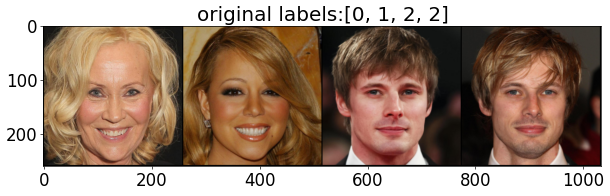

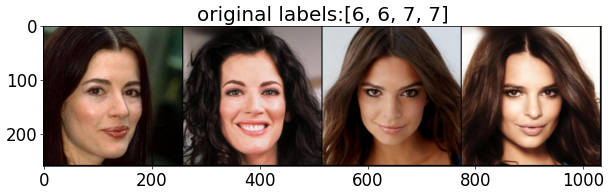

[Start Image Examples]


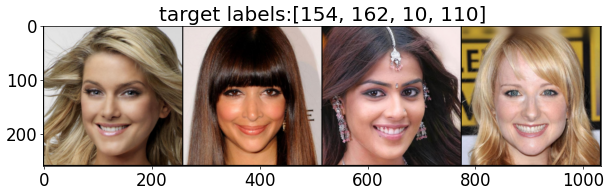

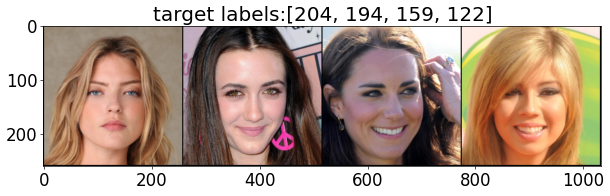

[Attack Result Examples]


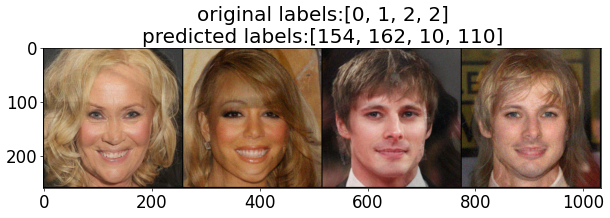

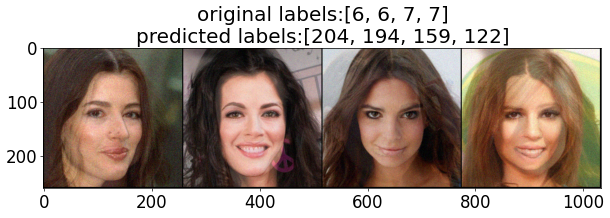

[Step #0] Loss: 0.3782 Accuracy: 0.0000% Attack success rate: 100.0000% Time elapsed: 41.7563s (total 8 images)
[Size of Perturbation]
Average L0 distance (the number of changed parameters): 196564.375
Average L2 distance: 44.600791931152344
Average MSE (from Start): 0.054379481822252274
Average MSE: 0.012245871126651764
Average Linf distance (the maximum changed values): 0.3532244861125946
[Attack start for one batch]
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.4551, 0.6575, 0.7308, 0.6161, 0.4631, 0.6088, 0.5074, 0.7934],
                     device='cuda:0'))
Binary step count: 27
Gradient step count: 100
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.9703, 0.8984, 0.9235, 0.8717, 0.9684, 0.9606, 0.9522, 0.9697],
                     device='cuda:0'))
Binary step count: 26
Gradient step count: 141
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.7791, 

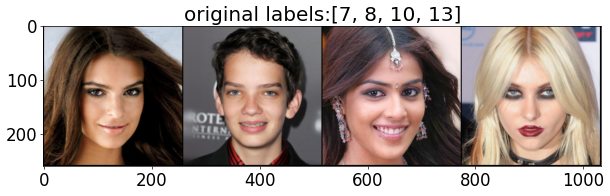

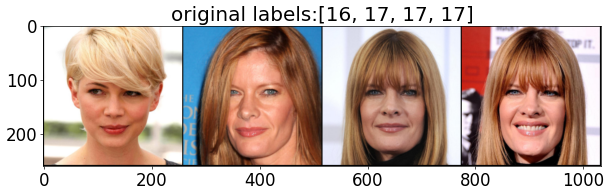

[Start Image Examples]


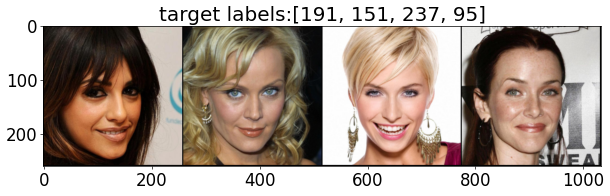

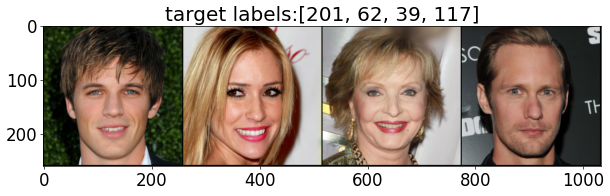

[Attack Result Examples]


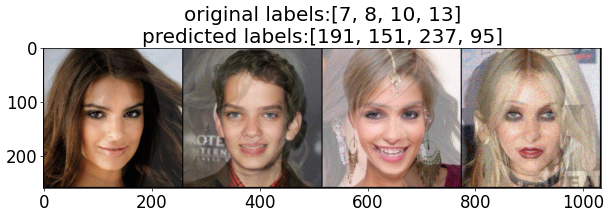

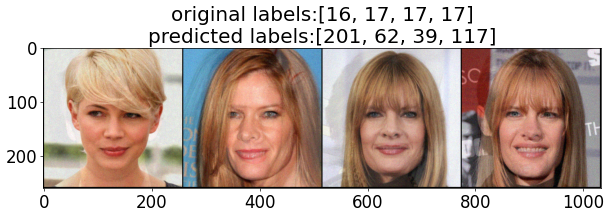

[Step #1] Loss: 0.3667 Accuracy: 0.0000% Attack success rate: 100.0000% Time elapsed: 82.5626s (total 16 images)
[Size of Perturbation]
Average L0 distance (the number of changed parameters): 196510.125
Average L2 distance: 49.9339714050293
Average MSE (from Start): 0.07192973606288433
Average MSE: 0.01615734025835991
Average Linf distance (the maximum changed values): 0.3637326508760452
[Attack start for one batch]
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.5801, 0.6132, 0.5096, 0.7494, 0.7147, 0.6244, 0.6214, 0.6394],
                     device='cuda:0'))
Binary step count: 26
Gradient step count: 100
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.9857, 0.8047, 0.8117, 0.9988, 0.9092, 0.9698, 0.8943, 0.9800],
                     device='cuda:0'))
Binary step count: 26
Gradient step count: 141
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.9236, 0.9

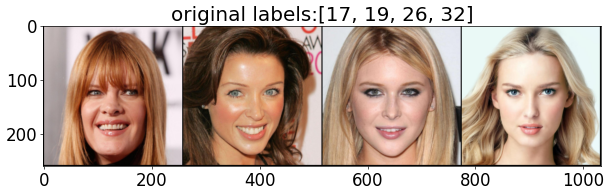

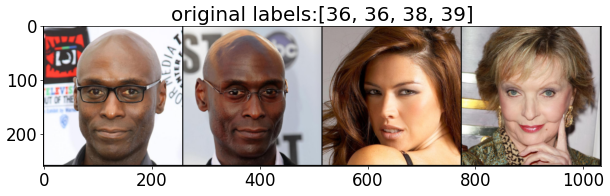

[Start Image Examples]


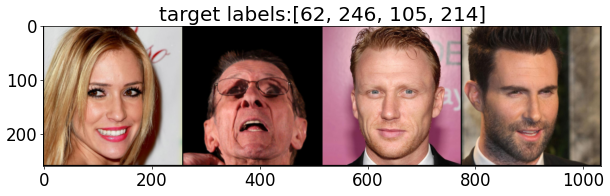

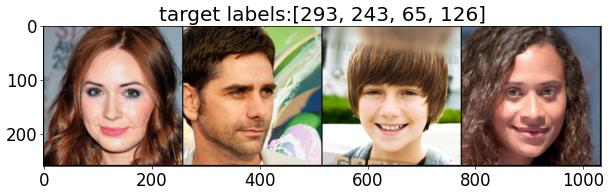

[Attack Result Examples]


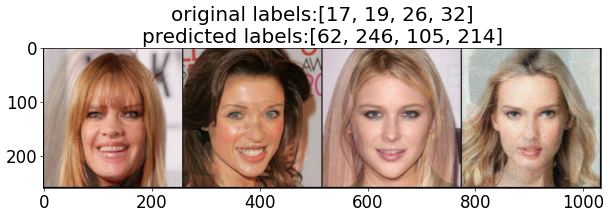

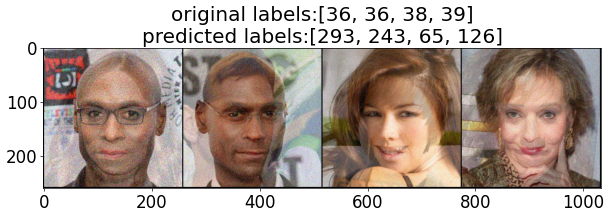

[Step #2] Loss: 0.3935 Accuracy: 0.0000% Attack success rate: 100.0000% Time elapsed: 123.2280s (total 24 images)
[Size of Perturbation]
Average L0 distance (the number of changed parameters): 196532.25
Average L2 distance: 50.13864262898763
Average MSE (from Start): 0.07176108037432034
Average MSE: 0.01559313697119554
Average Linf distance (the maximum changed values): 0.38085270921389264
[Attack start for one batch]
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.8096, 0.5966, 0.3482, 0.6498, 0.5237, 0.4402, 0.6408, 0.7552],
                     device='cuda:0'))
Binary step count: 27
Gradient step count: 100
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.9345, 0.7133, 0.9239, 0.9879, 0.7771, 0.9529, 0.8364, 0.9428],
                     device='cuda:0'))
Binary step count: 26
Gradient step count: 141
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.8570, 0

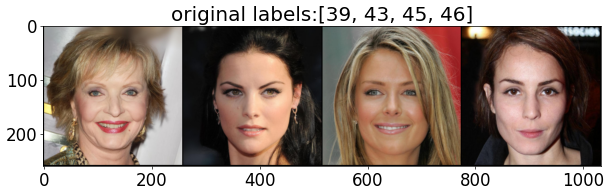

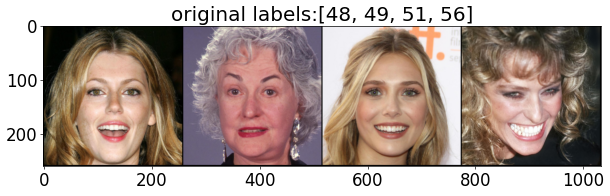

[Start Image Examples]


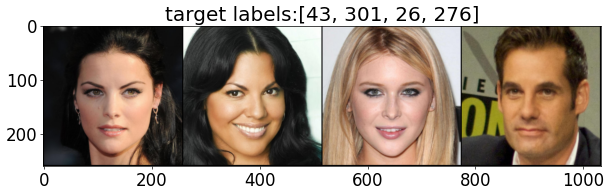

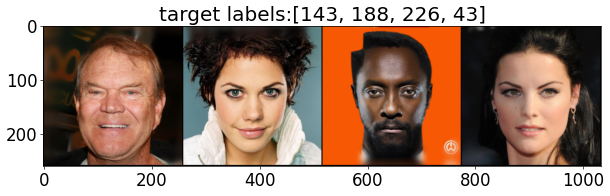

[Attack Result Examples]


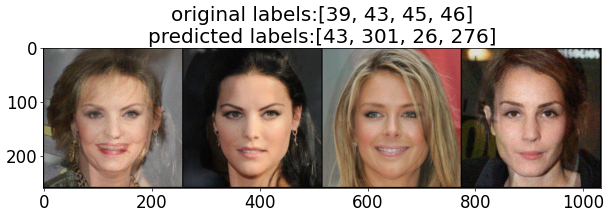

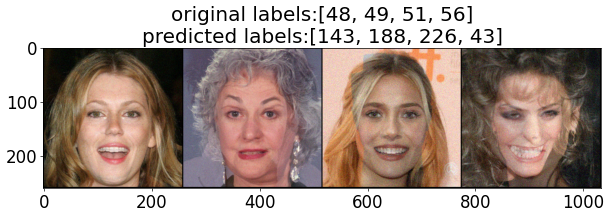

[Step #3] Loss: 0.3990 Accuracy: 0.0000% Attack success rate: 100.0000% Time elapsed: 164.0208s (total 32 images)
[Size of Perturbation]
Average L0 distance (the number of changed parameters): 196543.9375
Average L2 distance: 48.22854709625244
Average MSE (from Start): 0.07031876314431429
Average MSE: 0.01452418020926416
Average Linf distance (the maximum changed values): 0.3673187866806984
[Attack start for one batch]
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.4933, 0.5535, 0.6682, 0.6595, 0.4373, 0.7890, 0.7360, 0.5827],
                     device='cuda:0'))
Binary step count: 27
Gradient step count: 100
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.9917, 0.9627, 0.9682, 0.9911, 0.9421, 0.8645, 0.9656, 0.6044],
                     device='cuda:0'))
Binary step count: 26
Gradient step count: 141
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.9440, 

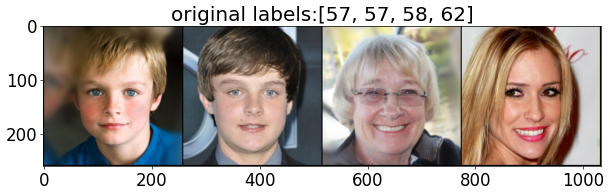

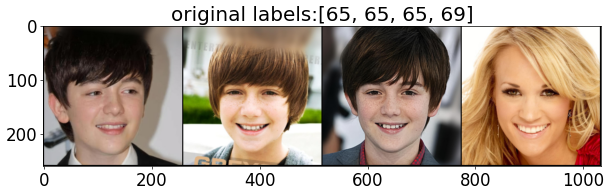

[Start Image Examples]


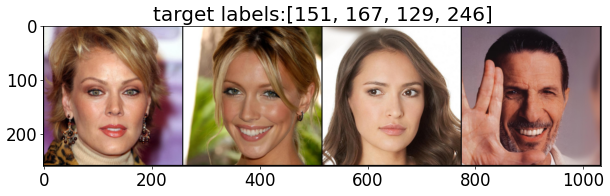

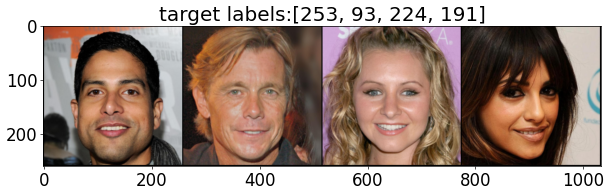

[Attack Result Examples]


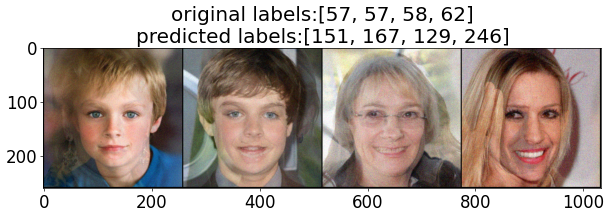

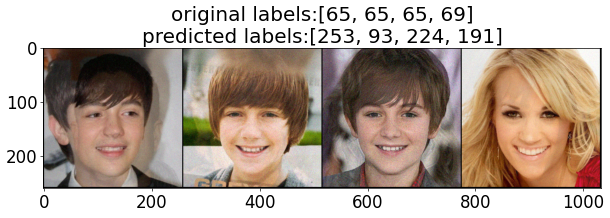

[Step #4] Loss: 0.3989 Accuracy: 0.0000% Attack success rate: 100.0000% Time elapsed: 204.6308s (total 40 images)
[Size of Perturbation]
Average L0 distance (the number of changed parameters): 196546.675
Average L2 distance: 47.20547866821289
Average MSE (from Start): 0.07131356373429298
Average MSE: 0.013634447939693928
Average Linf distance (the maximum changed values): 0.3624455451965332
[Attack start for one batch]
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.6393, 0.5679, 0.6453, 0.3566, 0.5540, 0.3727, 0.6405, 0.3718],
                     device='cuda:0'))
Binary step count: 27
Gradient step count: 100
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.9549, 0.9951, 0.8801, 0.7591, 0.9827, 0.9985, 0.9640, 0.7410],
                     device='cuda:0'))
Binary step count: 26
Gradient step count: 141
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.9736, 

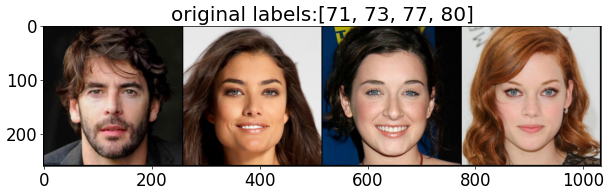

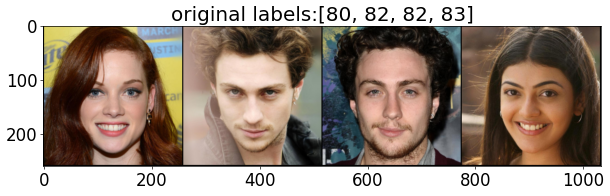

[Start Image Examples]


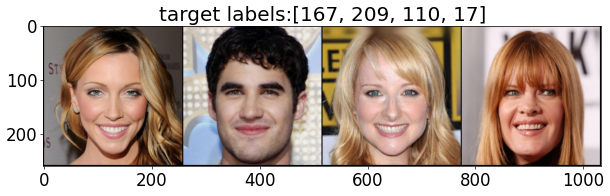

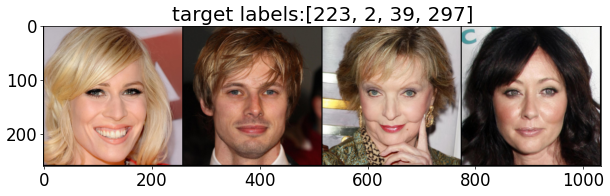

[Attack Result Examples]


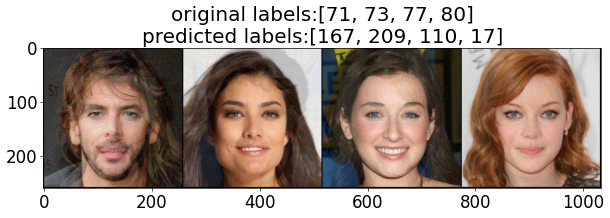

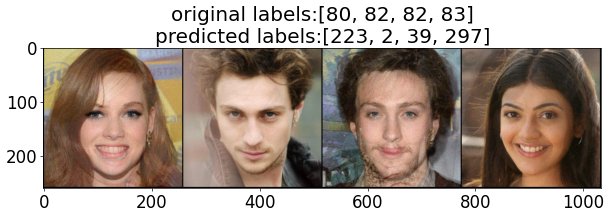

[Step #5] Loss: 0.3990 Accuracy: 0.0000% Attack success rate: 100.0000% Time elapsed: 245.3797s (total 48 images)
[Size of Perturbation]
Average L0 distance (the number of changed parameters): 196550.54166666666
Average L2 distance: 45.65230623881022
Average MSE (from Start): 0.070993031685551
Average MSE: 0.012764166885366043
Average Linf distance (the maximum changed values): 0.35109645624955493
[Attack start for one batch]
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.3511, 0.5025, 0.4711, 0.7080, 0.3842, 0.6851, 0.4072, 0.5079],
                     device='cuda:0'))
Binary step count: 27
Gradient step count: 100
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.5510, 0.9434, 0.9885, 0.9023, 0.8320, 0.8996, 0.9430, 0.7300],
                     device='cuda:0'))
Binary step count: 26
Gradient step count: 141
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0

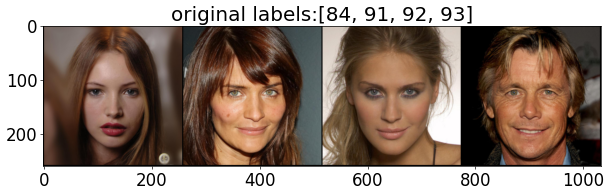

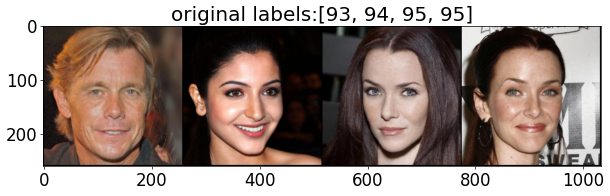

[Start Image Examples]


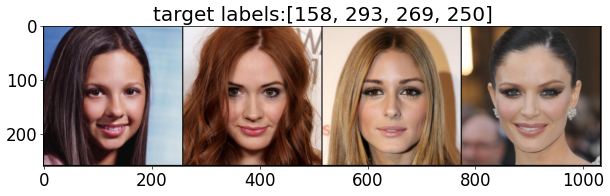

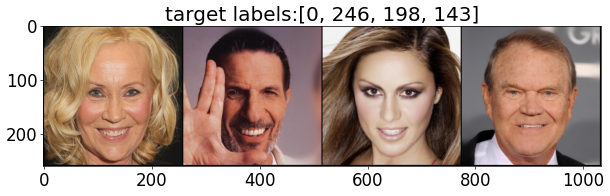

[Attack Result Examples]


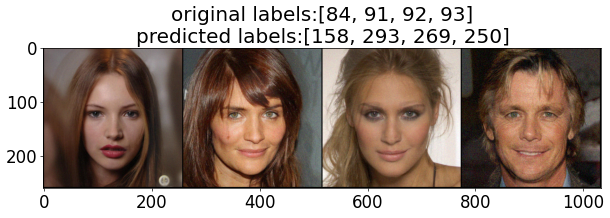

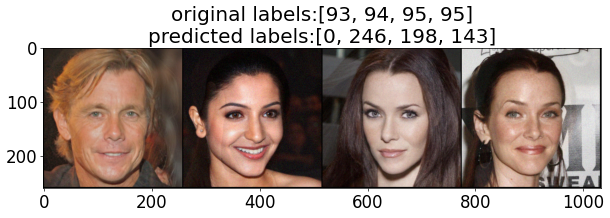

[Step #6] Loss: 0.3733 Accuracy: 0.0000% Attack success rate: 100.0000% Time elapsed: 286.2125s (total 56 images)
[Size of Perturbation]
Average L0 distance (the number of changed parameters): 196528.5
Average L2 distance: 42.20477485656738
Average MSE (from Start): 0.07071557907121521
Average MSE: 0.011309977886932237
Average Linf distance (the maximum changed values): 0.3296454186950411
[Attack start for one batch]
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.4815, 0.6579, 0.6409, 0.6326, 0.5409, 0.6202, 0.5404, 0.4370],
                     device='cuda:0'))
Binary step count: 27
Gradient step count: 100
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.8121, 0.7662, 0.9454, 0.9658, 0.8388, 0.9150, 0.9299, 0.9672],
                     device='cuda:0'))
Binary step count: 26
Gradient step count: 141
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.9461, 0.

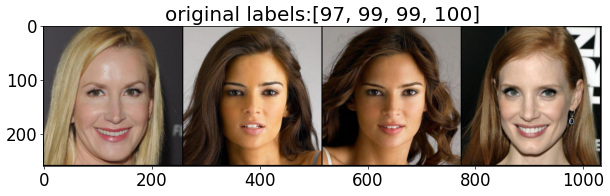

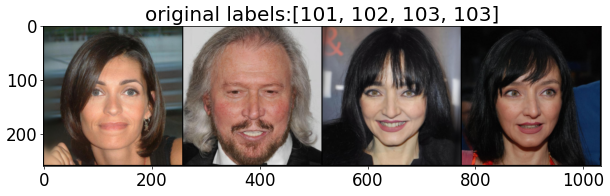

[Start Image Examples]


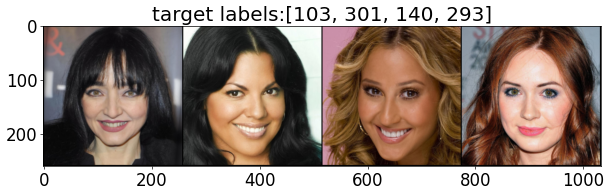

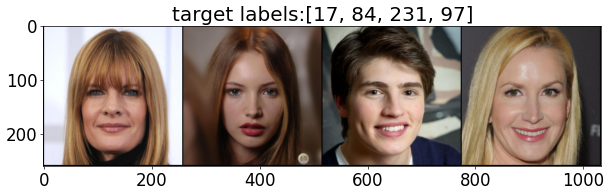

[Attack Result Examples]


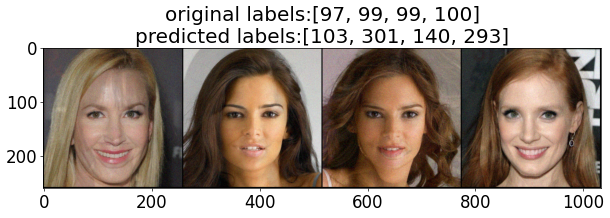

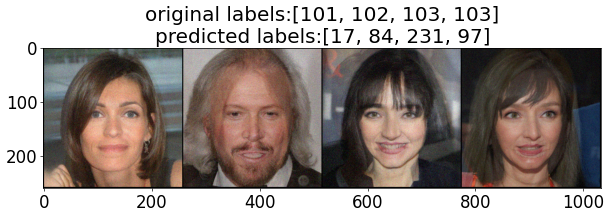

[Step #7] Loss: 0.3590 Accuracy: 0.0000% Attack success rate: 100.0000% Time elapsed: 326.9704s (total 64 images)
[Size of Perturbation]
Average L0 distance (the number of changed parameters): 196536.546875
Average L2 distance: 41.23886322975159
Average MSE (from Start): 0.06989290611818433
Average MSE: 0.010681050131097436
Average Linf distance (the maximum changed values): 0.32483879663050175
[Attack start for one batch]
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.5618, 0.6079, 0.4436, 0.5656, 0.3484, 0.5892, 0.6174, 0.5485],
                     device='cuda:0'))
Binary step count: 27
Gradient step count: 100
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.7529, 0.9772, 0.6841, 0.9544, 0.9030, 0.8228, 0.9626, 0.8533],
                     device='cuda:0'))
Binary step count: 26
Gradient step count: 141
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.90

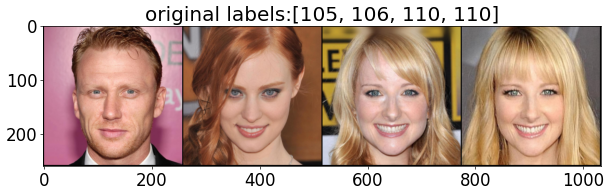

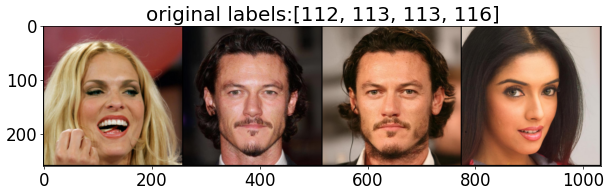

[Start Image Examples]


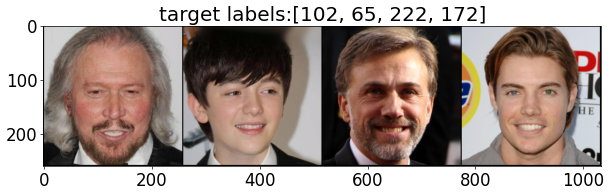

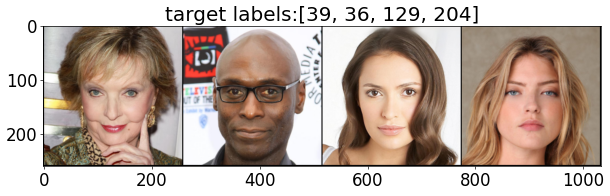

[Attack Result Examples]


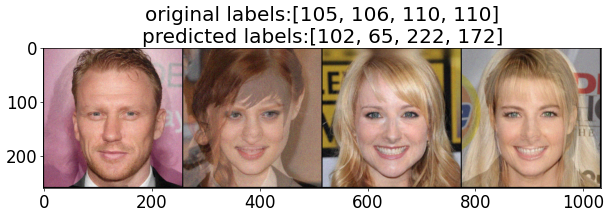

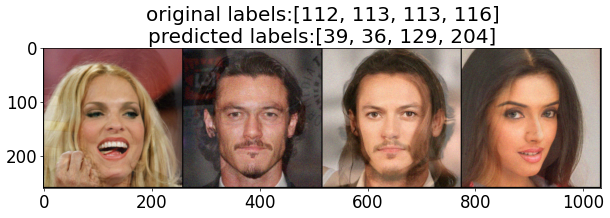

[Step #8] Loss: 0.3601 Accuracy: 0.0000% Attack success rate: 100.0000% Time elapsed: 368.0118s (total 72 images)
[Size of Perturbation]
Average L0 distance (the number of changed parameters): 196544.31944444444
Average L2 distance: 41.55273289150662
Average MSE (from Start): 0.07026885077357292
Average MSE: 0.010777954633037249
Average Linf distance (the maximum changed values): 0.3247696277168062
[Attack start for one batch]
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.5249, 0.5522, 0.5624, 0.6256, 0.4350, 0.3746, 0.5347, 0.4429],
                     device='cuda:0'))
Binary step count: 27
Gradient step count: 100
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.8895, 0.6983, 0.9117, 0.9211, 0.8688, 0.8523, 0.7039, 0.9517],
                     device='cuda:0'))
Binary step count: 26
Gradient step count: 141
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([

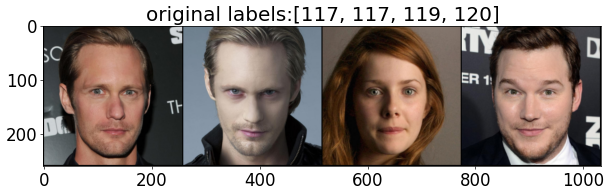

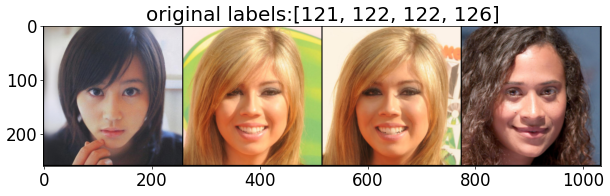

[Start Image Examples]


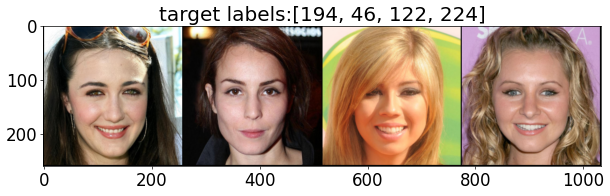

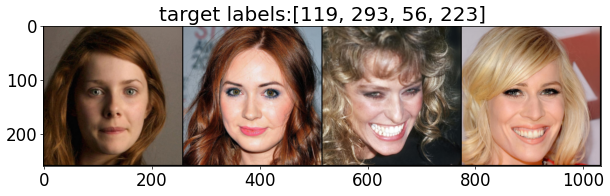

[Attack Result Examples]


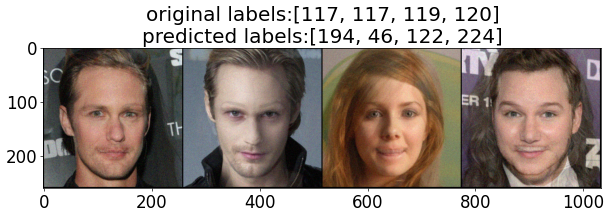

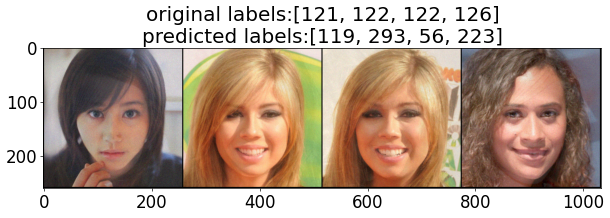

[Step #9] Loss: 0.3640 Accuracy: 0.0000% Attack success rate: 100.0000% Time elapsed: 408.9120s (total 80 images)
[Size of Perturbation]
Average L0 distance (the number of changed parameters): 196546.3375
Average L2 distance: 40.787469673156735
Average MSE (from Start): 0.07062210626900196
Average MSE: 0.010360268596559762
Average Linf distance (the maximum changed values): 0.3193619981408119
[Attack start for one batch]
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.4811, 0.6844, 0.6513, 0.4828, 0.6836, 0.5105, 0.7479, 0.5930],
                     device='cuda:0'))
Binary step count: 27
Gradient step count: 100
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.6944, 0.6717, 0.9378, 0.8702, 0.9675, 0.8929, 0.9708, 0.9290],
                     device='cuda:0'))
Binary step count: 26
Gradient step count: 141
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.8753

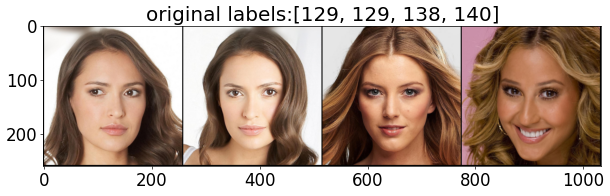

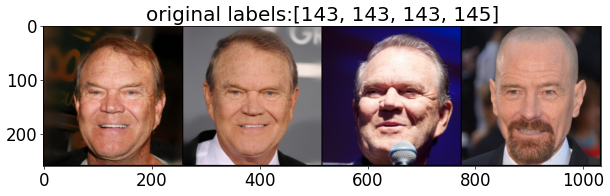

[Start Image Examples]


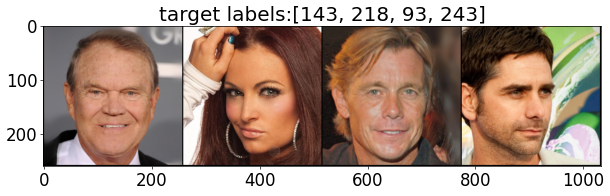

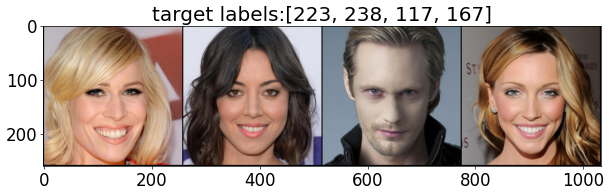

[Attack Result Examples]


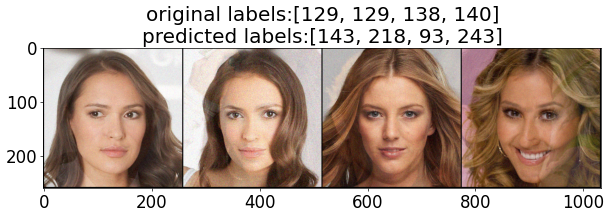

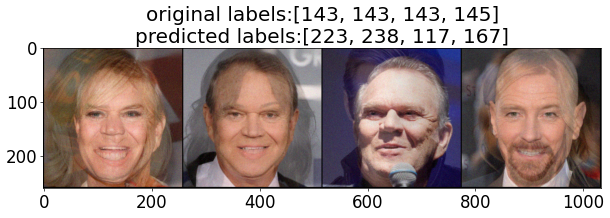

[Step #10] Loss: 0.3565 Accuracy: 0.0000% Attack success rate: 100.0000% Time elapsed: 449.9428s (total 88 images)
[Size of Perturbation]
Average L0 distance (the number of changed parameters): 196549.72727272726
Average L2 distance: 40.97464214671742
Average MSE (from Start): 0.0701339038258249
Average MSE: 0.010383664376356384
Average Linf distance (the maximum changed values): 0.3200730613686822
[Attack start for one batch]
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.5311, 0.9153, 0.6292, 0.5772, 0.6489, 0.5116, 0.6022, 0.5330],
                     device='cuda:0'))
Binary step count: 26
Gradient step count: 100
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.9710, 0.8987, 0.9701, 0.9627, 0.8351, 0.7571, 0.9561, 0.9720],
                     device='cuda:0'))
Binary step count: 26
Gradient step count: 141
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([

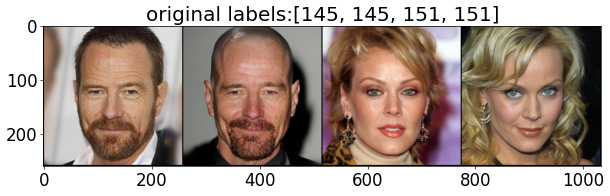

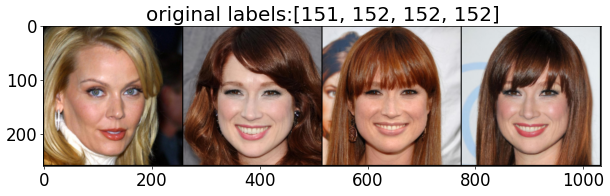

[Start Image Examples]


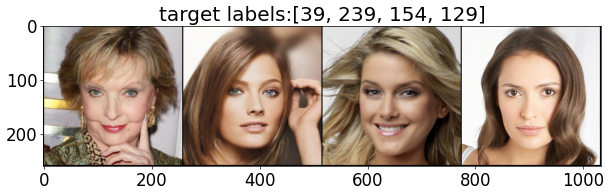

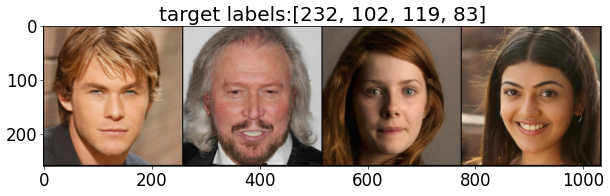

[Attack Result Examples]


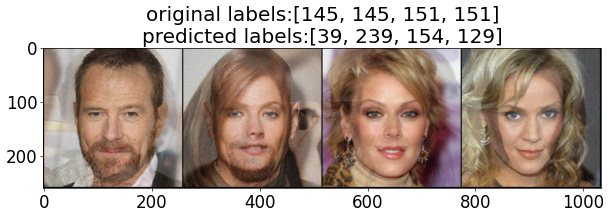

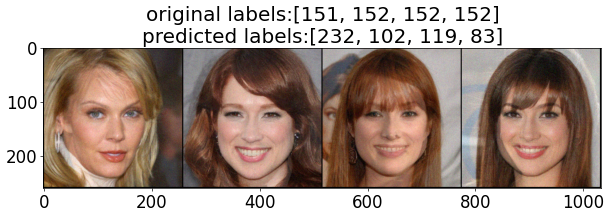

[Step #11] Loss: 0.3693 Accuracy: 0.0000% Attack success rate: 100.0000% Time elapsed: 490.9557s (total 96 images)
[Size of Perturbation]
Average L0 distance (the number of changed parameters): 196554.26041666666
Average L2 distance: 41.54159879684448
Average MSE (from Start): 0.06851080774019162
Average MSE: 0.010581723569581905
Average Linf distance (the maximum changed values): 0.3251783934732278
[Attack start for one batch]
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.4485, 0.5743, 0.4102, 0.7068, 0.7851, 0.6299, 0.6133, 0.6106],
                     device='cuda:0'))
Binary step count: 27
Gradient step count: 100
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.9624, 0.9787, 0.9226, 0.8238, 0.8761, 0.9507, 0.8250, 0.9127],
                     device='cuda:0'))
Binary step count: 26
Gradient step count: 141
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor(

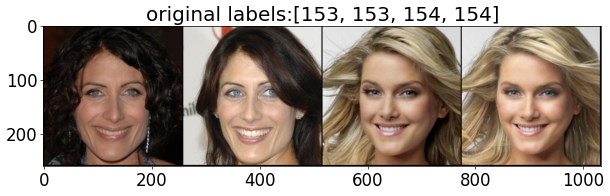

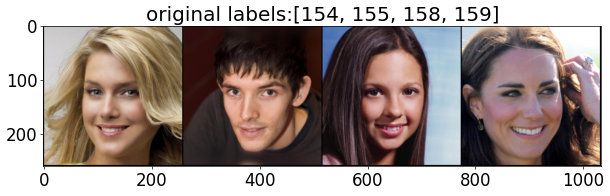

[Start Image Examples]


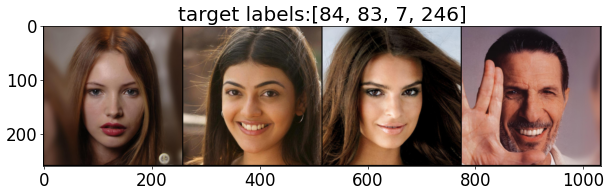

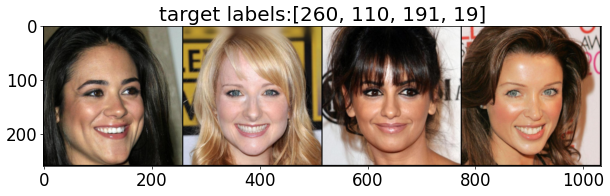

[Attack Result Examples]


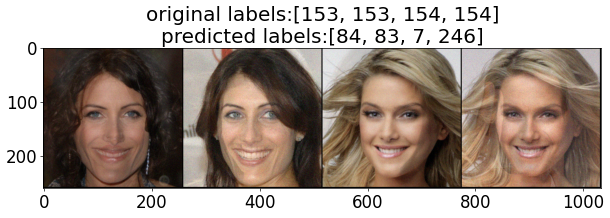

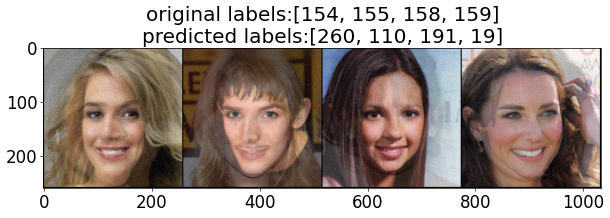

[Step #12] Loss: 0.3667 Accuracy: 0.0000% Attack success rate: 100.0000% Time elapsed: 531.8417s (total 104 images)
[Size of Perturbation]
Average L0 distance (the number of changed parameters): 196553.98076923078
Average L2 distance: 41.57442312974196
Average MSE (from Start): 0.0675350522192625
Average MSE: 0.010541425444758855
Average Linf distance (the maximum changed values): 0.32629708028756654
[Attack start for one batch]
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.4114, 0.5205, 0.5680, 0.5152, 0.5333, 0.6063, 0.4813, 0.7013],
                     device='cuda:0'))
Binary step count: 27
Gradient step count: 100
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.9113, 0.9527, 0.9338, 0.9499, 0.9861, 0.8745, 0.9193, 0.5092],
                     device='cuda:0'))
Binary step count: 26
Gradient step count: 141
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor

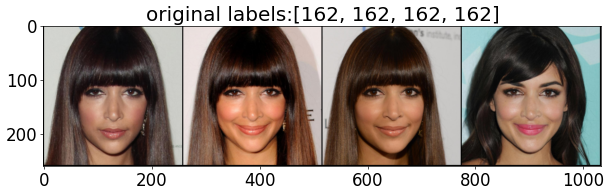

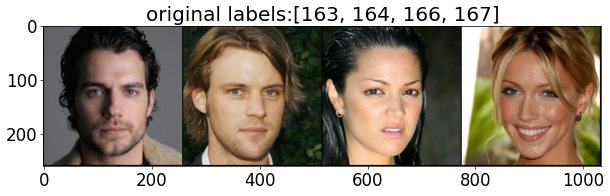

[Start Image Examples]


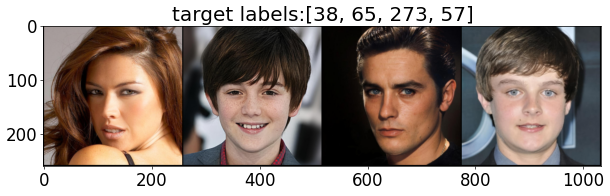

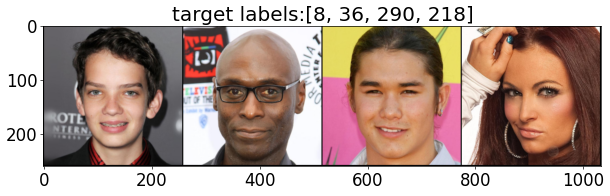

[Attack Result Examples]


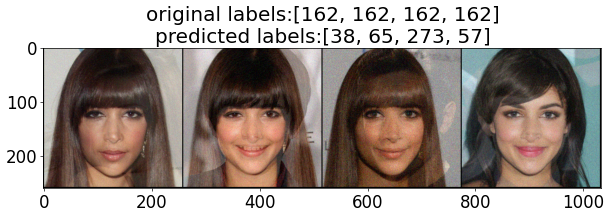

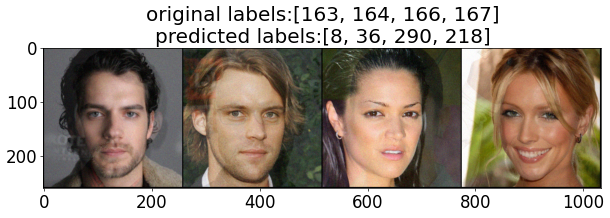

[Step #13] Loss: 0.3544 Accuracy: 0.0000% Attack success rate: 100.0000% Time elapsed: 572.8247s (total 112 images)
[Size of Perturbation]
Average L0 distance (the number of changed parameters): 196544.73214285713
Average L2 distance: 41.25599956512451
Average MSE (from Start): 0.06912972591817379
Average MSE: 0.010334100274901305
Average Linf distance (the maximum changed values): 0.3247029430099896
[Attack start for one batch]
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.3724, 0.7523, 0.5689, 0.6540, 0.3845, 0.5486, 0.6026, 0.5184],
                     device='cuda:0'))
Binary step count: 27
Gradient step count: 100
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.9033, 0.8960, 0.7675, 0.9262, 0.9222, 0.9693, 0.9164, 0.9306],
                     device='cuda:0'))
Binary step count: 26
Gradient step count: 141
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor

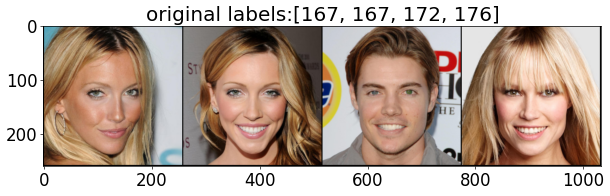

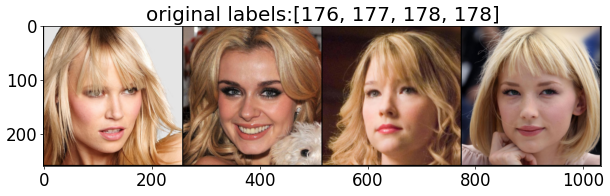

[Start Image Examples]


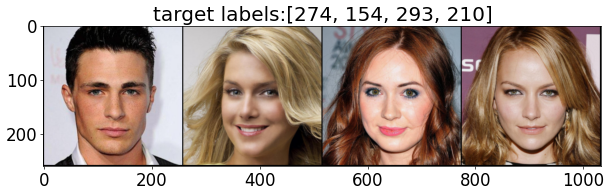

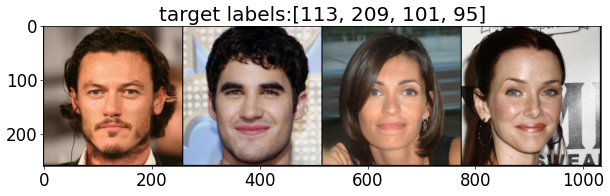

[Attack Result Examples]


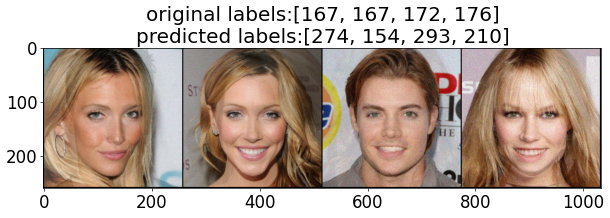

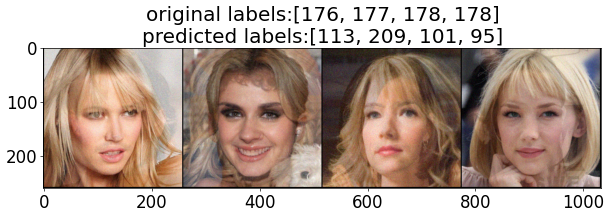

[Step #14] Loss: 0.3577 Accuracy: 0.0000% Attack success rate: 100.0000% Time elapsed: 613.8299s (total 120 images)
[Size of Perturbation]
Average L0 distance (the number of changed parameters): 196548.63333333333
Average L2 distance: 41.008396021525066
Average MSE (from Start): 0.06868995403250058
Average MSE: 0.010173248530675968
Average Linf distance (the maximum changed values): 0.32329422732194263
[Attack start for one batch]
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.6167, 0.3793, 0.5127, 0.5504, 0.5241, 0.5620, 0.5814, 0.5365],
                     device='cuda:0'))
Binary step count: 27
Gradient step count: 100
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.7406, 0.8888, 0.8718, 0.8792, 0.7472, 0.9800, 0.9320, 0.9278],
                     device='cuda:0'))
Binary step count: 26
Gradient step count: 141
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tens

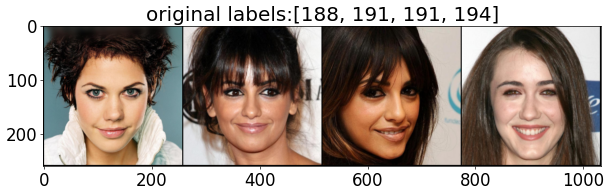

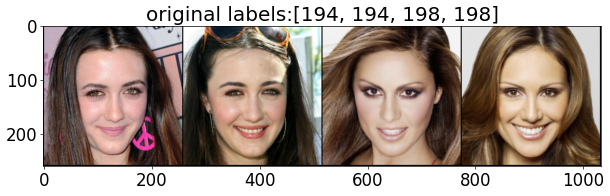

[Start Image Examples]


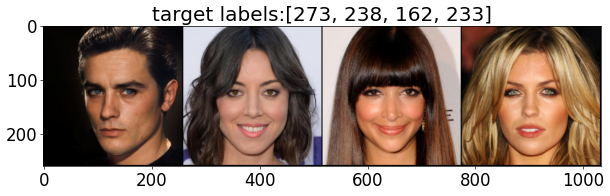

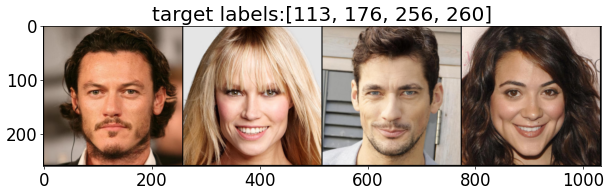

[Attack Result Examples]


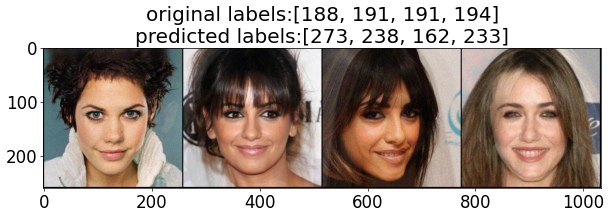

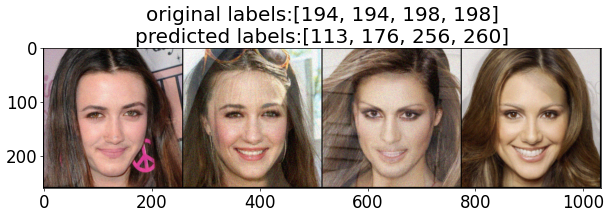

[Step #15] Loss: 0.3497 Accuracy: 0.0000% Attack success rate: 100.0000% Time elapsed: 654.8138s (total 128 images)
[Size of Perturbation]
Average L0 distance (the number of changed parameters): 196549.0390625
Average L2 distance: 40.617902398109436
Average MSE (from Start): 0.06884716334752738
Average MSE: 0.009959223592886701
Average Linf distance (the maximum changed values): 0.3215982234105468
[Attack start for one batch]
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.4241, 0.6676, 0.5835, 0.6469, 0.6049, 0.5127, 0.4136, 0.5623],
                     device='cuda:0'))
Binary step count: 27
Gradient step count: 100
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.8348, 0.9560, 0.9379, 0.9760, 0.9766, 0.9418, 0.9954, 0.9356],
                     device='cuda:0'))
Binary step count: 26
Gradient step count: 141
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0

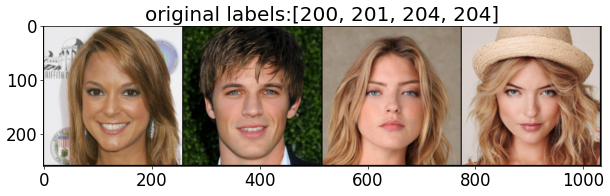

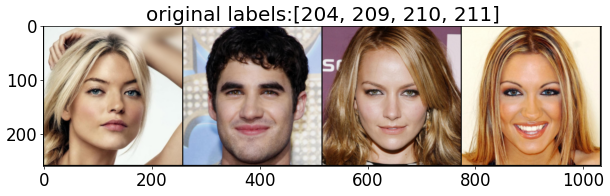

[Start Image Examples]


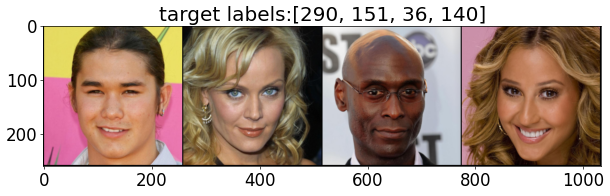

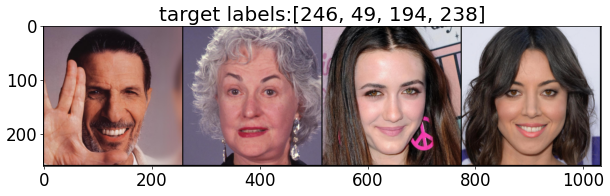

[Attack Result Examples]


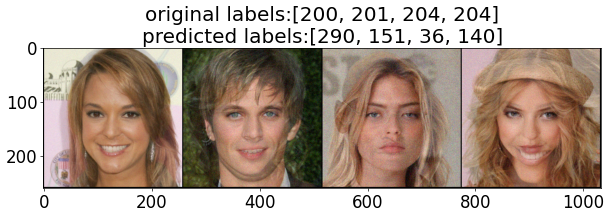

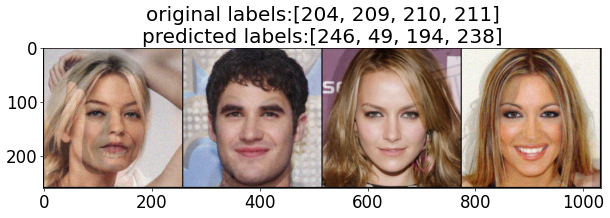

[Step #16] Loss: 0.3572 Accuracy: 0.0000% Attack success rate: 100.0000% Time elapsed: 695.8278s (total 136 images)
[Size of Perturbation]
Average L0 distance (the number of changed parameters): 196548.76470588235
Average L2 distance: 40.62382698059082
Average MSE (from Start): 0.06767480710850042
Average MSE: 0.009924453655805658
Average Linf distance (the maximum changed values): 0.3224347347722334
[Attack start for one batch]
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.6024, 0.4351, 0.6240, 0.4637, 0.5337, 0.4498, 0.5721, 0.5014],
                     device='cuda:0'))
Binary step count: 27
Gradient step count: 100
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.9457, 0.7624, 0.9913, 0.9529, 0.8544, 0.9380, 0.8135, 0.9166],
                     device='cuda:0'))
Binary step count: 26
Gradient step count: 141
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor

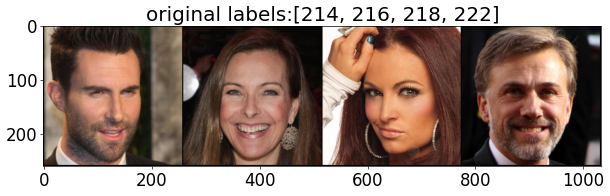

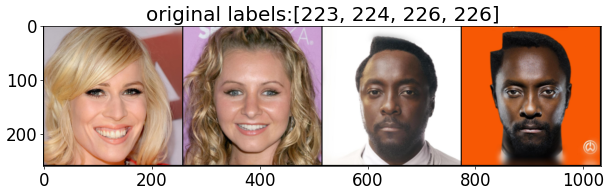

[Start Image Examples]


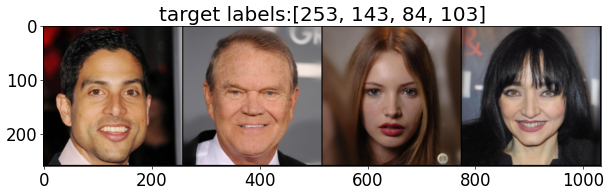

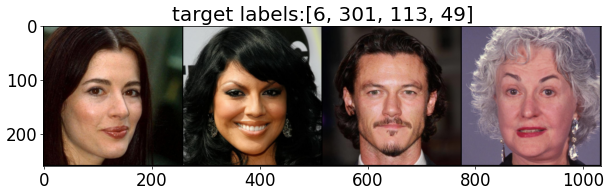

[Attack Result Examples]


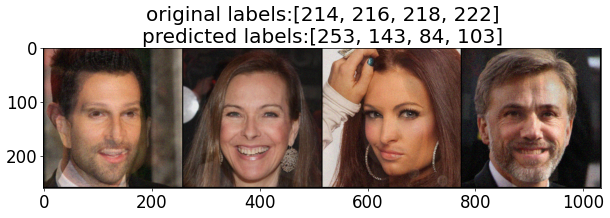

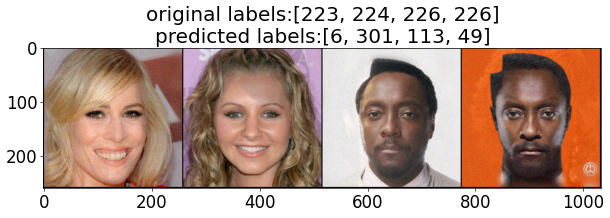

[Step #17] Loss: 0.3496 Accuracy: 0.0000% Attack success rate: 100.0000% Time elapsed: 736.7890s (total 144 images)
[Size of Perturbation]
Average L0 distance (the number of changed parameters): 196550.70138888888
Average L2 distance: 40.21350277794732
Average MSE (from Start): 0.07031420059502125
Average MSE: 0.009703973851477107
Average Linf distance (the maximum changed values): 0.31900686770677567
[Attack start for one batch]
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.6279, 0.5110, 0.4544, 0.5960, 0.5683, 0.6438, 0.5243, 0.5501],
                     device='cuda:0'))
Binary step count: 27
Gradient step count: 100
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.9811, 0.9297, 0.7440, 0.9339, 0.7288, 0.8609, 0.9223, 0.9527],
                     device='cuda:0'))
Binary step count: 26
Gradient step count: 141
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tenso

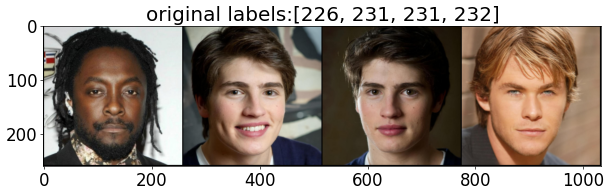

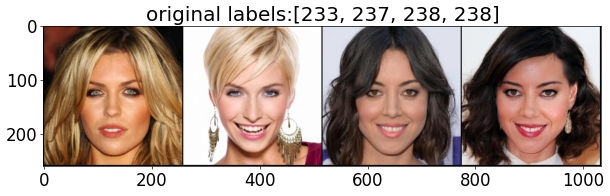

[Start Image Examples]


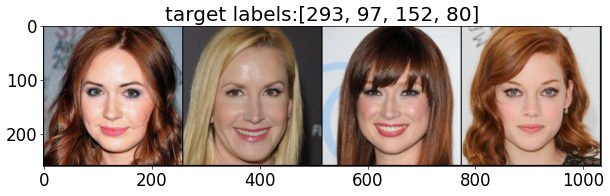

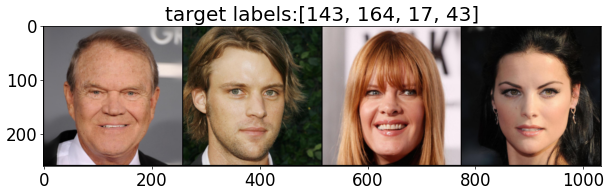

[Attack Result Examples]


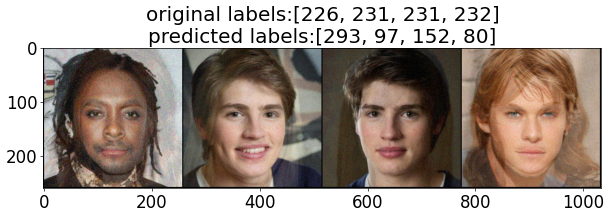

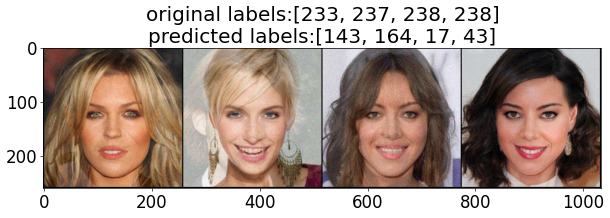

[Step #18] Loss: 0.3500 Accuracy: 0.0000% Attack success rate: 100.0000% Time elapsed: 777.7816s (total 152 images)
[Size of Perturbation]
Average L0 distance (the number of changed parameters): 196550.57236842104
Average L2 distance: 40.49568005612022
Average MSE (from Start): 0.07111326271766111
Average MSE: 0.009845319865761619
Average Linf distance (the maximum changed values): 0.3204032472873989
[Attack start for one batch]
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.7325, 0.4121, 0.5482, 0.6233, 0.6730, 0.6418, 0.8103, 0.4486],
                     device='cuda:0'))
Binary step count: 27
Gradient step count: 100
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.9185, 0.8483, 0.8642, 0.9714, 0.9146, 0.9881, 0.9361, 0.8972],
                     device='cuda:0'))
Binary step count: 26
Gradient step count: 141
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor

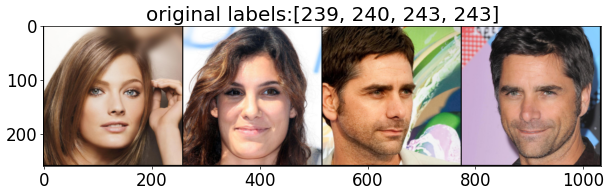

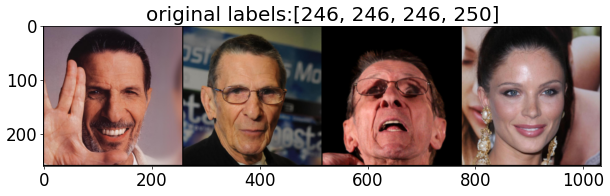

[Start Image Examples]


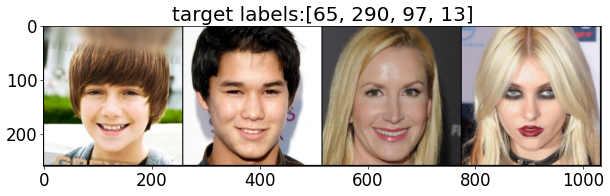

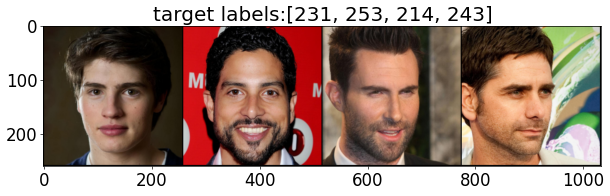

[Attack Result Examples]


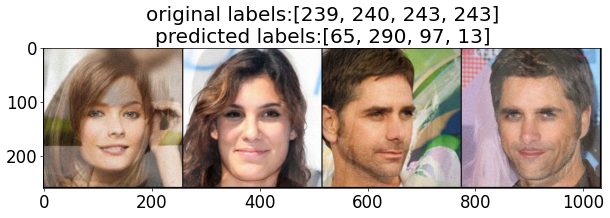

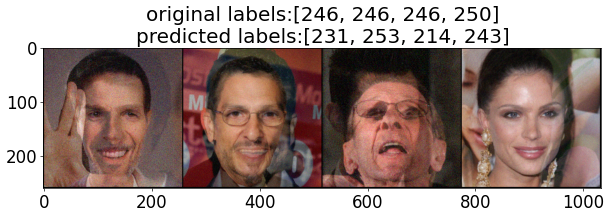

[Step #19] Loss: 0.3542 Accuracy: 0.0000% Attack success rate: 100.0000% Time elapsed: 818.6750s (total 160 images)
[Size of Perturbation]
Average L0 distance (the number of changed parameters): 196512.74375
Average L2 distance: 40.82176351547241
Average MSE (from Start): 0.07094018254429102
Average MSE: 0.009974464937113226
Average Linf distance (the maximum changed values): 0.3226473219692707
[Attack start for one batch]
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.3607, 0.6766, 0.5555, 0.6024, 0.6820, 0.6440, 0.5769, 0.6054],
                     device='cuda:0'))
Binary step count: 27
Gradient step count: 100
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.9270, 0.8870, 0.9044, 0.9563, 0.8414, 0.9978, 0.9769, 0.7675],
                     device='cuda:0'))
Binary step count: 26
Gradient step count: 141
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.78

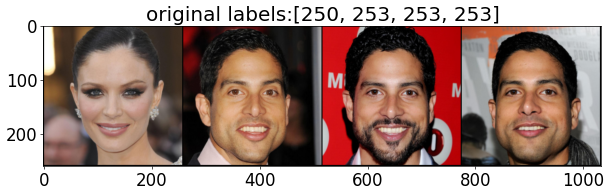

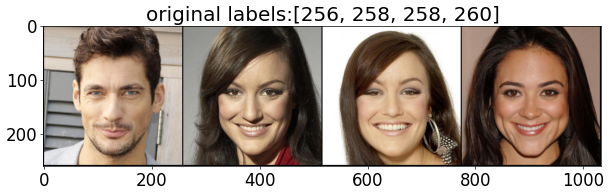

[Start Image Examples]


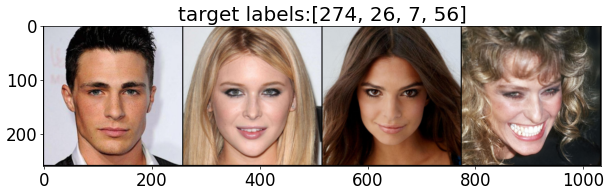

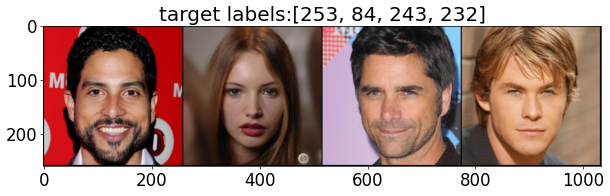

[Attack Result Examples]


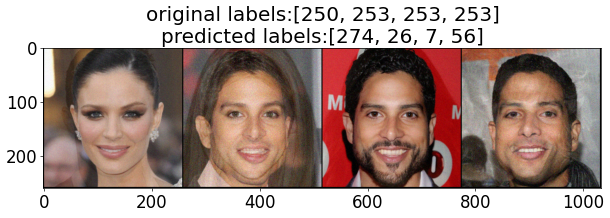

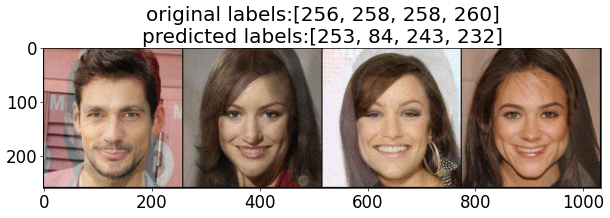

[Step #20] Loss: 0.3546 Accuracy: 0.0000% Attack success rate: 100.0000% Time elapsed: 859.7739s (total 168 images)
[Size of Perturbation]
Average L0 distance (the number of changed parameters): 196498.07738095237
Average L2 distance: 40.89179602123442
Average MSE (from Start): 0.07114904214228902
Average MSE: 0.009984848732572226
Average Linf distance (the maximum changed values): 0.32336586500917164
[Attack start for one batch]
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.5157, 0.4754, 0.7243, 0.3966, 0.5458, 0.5583, 0.5603, 0.3495],
                     device='cuda:0'))
Binary step count: 27
Gradient step count: 100
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.9550, 0.8856, 0.9582, 0.6822, 0.9143, 0.8251, 0.8610, 0.7778],
                     device='cuda:0'))
Binary step count: 26
Gradient step count: 141
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tenso

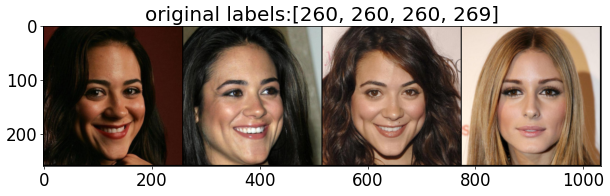

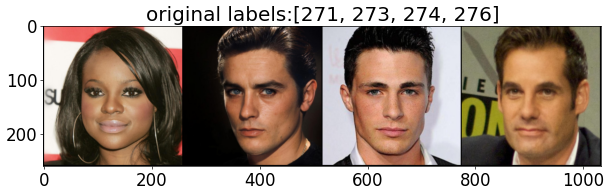

[Start Image Examples]


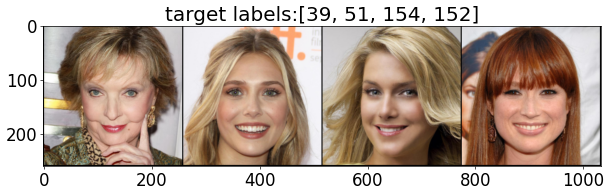

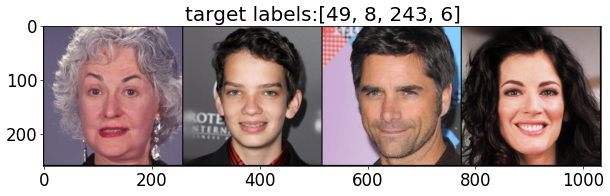

[Attack Result Examples]


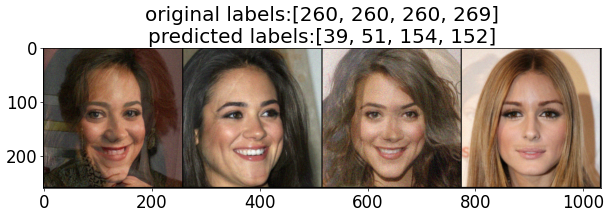

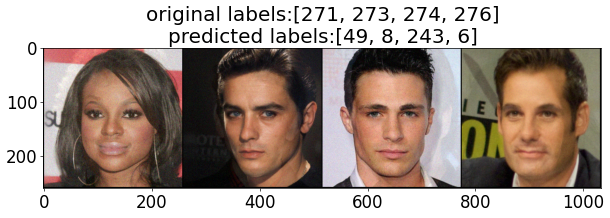

[Step #21] Loss: 0.3550 Accuracy: 0.0000% Attack success rate: 100.0000% Time elapsed: 900.7733s (total 176 images)
[Size of Perturbation]
Average L0 distance (the number of changed parameters): 196499.9659090909
Average L2 distance: 40.57326186786998
Average MSE (from Start): 0.07134382409805601
Average MSE: 0.009862625632773746
Average Linf distance (the maximum changed values): 0.32057620923627506
[Attack start for one batch]
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.3995, 0.5223, 0.5981, 0.5866, 0.5294, 0.6184, 0.4845, 0.4157],
                     device='cuda:0'))
Binary step count: 27
Gradient step count: 100
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.6948, 0.8408, 0.8827, 0.9553, 0.9314, 0.9051, 0.9856, 0.9938],
                     device='cuda:0'))
Binary step count: 26
Gradient step count: 141
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor

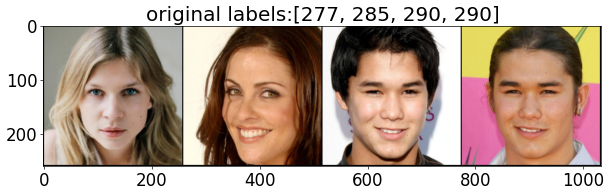

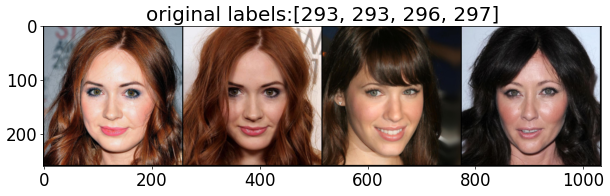

[Start Image Examples]


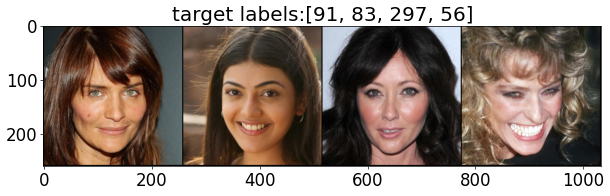

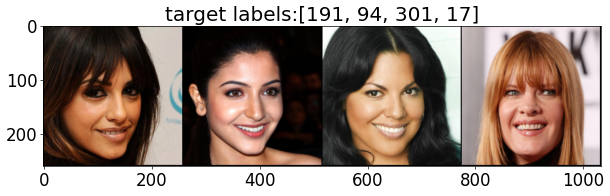

[Attack Result Examples]


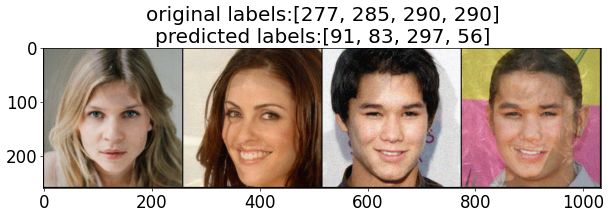

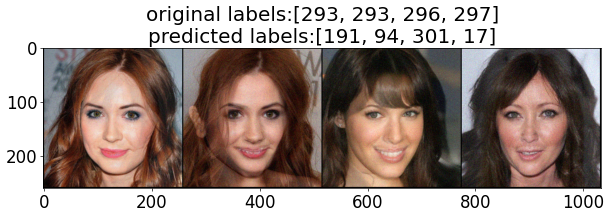

[Step #22] Loss: 0.3478 Accuracy: 0.0000% Attack success rate: 100.0000% Time elapsed: 941.6668s (total 184 images)
[Size of Perturbation]
Average L0 distance (the number of changed parameters): 196496.85869565216
Average L2 distance: 40.44488036114237
Average MSE (from Start): 0.07266776150335437
Average MSE: 0.009779873020623041
Average Linf distance (the maximum changed values): 0.31973417362441187
[Attack start for one batch]
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.5548, 0.6688, 0.7686, 0.6116, 0.3967, 0.7829, 0.6006],
                     device='cuda:0'))
Binary step count: 27
Gradient step count: 100
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.9099, 0.9085, 0.6537, 0.9461, 0.9358, 0.9282, 0.9460],
                     device='cuda:0'))
Binary step count: 26
Gradient step count: 141
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.8629, 0.712

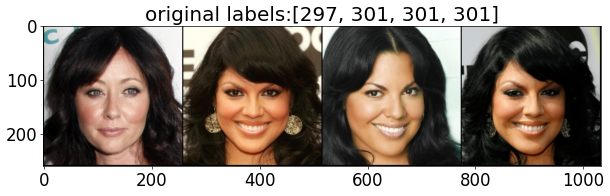

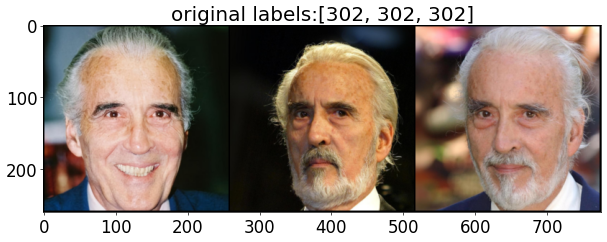

[Start Image Examples]


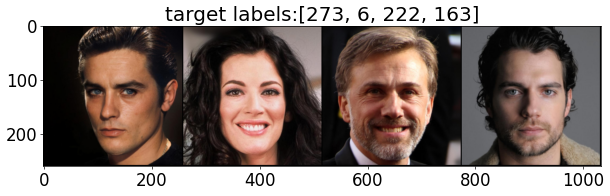

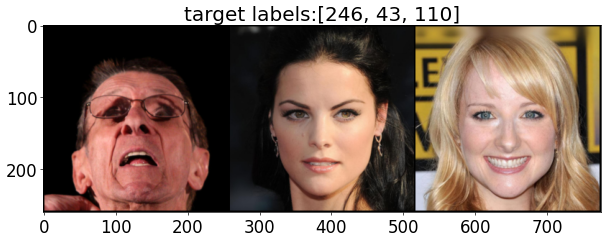

[Attack Result Examples]


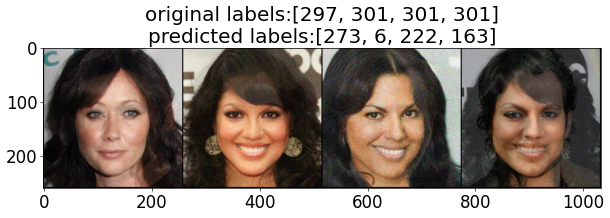

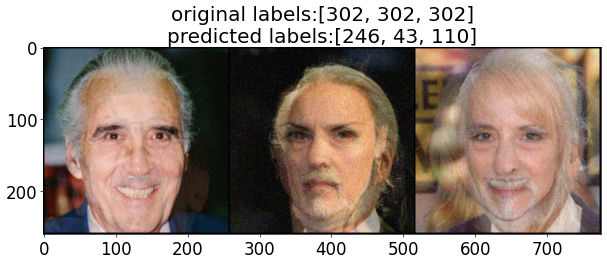

[Step #23] Loss: 0.3526 Accuracy: 0.0000% Attack success rate: 100.0000% Time elapsed: 977.4485s (total 191 images)
[Size of Perturbation]
Average L0 distance (the number of changed parameters): 196500.04188481675
Average L2 distance: 40.547799075461185
Average MSE (from Start): 0.07249045387612588
Average MSE: 0.009794419543593343
Average Linf distance (the maximum changed values): 0.32214013007298814
[Validation] Loss: 0.3526 Accuracy: 0.0000% Attack success rate: 100.0000% Time elapsed: 977.5366s (total 191 images)
[Size of Perturbation]
Average L0 distance (the number of changed parameters): 196500.04188481675
Average L2 distance: 40.547799075461185
Average MSE (from Start): 0.07249045387612588
Average MSE: 0.009794419543593343
Average Linf distance (the maximum changed values): 0.32214013007298814


In [ ]:
%autoreload 2

import time
from foolbox import criteria
import foolbox as fb

criterion = nn.CrossEntropyLoss()
model.eval()
start_time = time.time()

fmodel = fb.PyTorchModel(model, bounds=(0, 1))
attack = fb.attacks.HopSkipJump(init_attack=None, steps=100,
                                # initial_gradient_eval_steps=100, max_gradient_eval_steps=10000,
                                query_limit=3000)

running_loss = 0.
running_corrects = 0
running_success = 0
running_length = 0

running_l0 = 0
running_l2 = 0
running_mse = 0
running_mse_from_start = 0
running_linf = 0

for i, (inputs, npys, labels, target_inputs, target_npys, target_labels) in enumerate(test_dataloader):
    inputs = inputs.to(device)
    labels = labels.to(device)

    starting_points = target_inputs.to(device)
    target_labels = target_labels.to(device)

    attack_criterion = criteria.TargetedMisclassification(target_labels)
    _, adv_targeted, _ = attack(fmodel, inputs, criterion=attack_criterion, starting_points=starting_points, epsilons=None) # adversarial attack

    outputs = model(adv_targeted)
    _, preds = torch.max(outputs, 1)
    loss = criterion(outputs, labels)

    running_loss += loss.item()
    running_corrects += torch.sum(preds == labels.data)
    running_success += torch.sum(preds == target_labels.data)
    running_length += labels.shape[0]

    l0, l2, mse, linf = get_distance(adv_targeted, inputs)
    running_l0 += l0.sum().item()
    running_l2 += l2.sum().item()
    running_mse += mse.sum().item()
    running_mse_from_start += (adv_targeted - starting_points).view(adv_targeted.shape[0], -1).pow(2).mean(1).sum().item()
    running_linf += linf.sum().item()

    print('The dimension of an image tensor:', inputs.shape[1:])
    print('[Original Image Examples]')
    images = torchvision.utils.make_grid(inputs[:4])
    imshow(images.cpu(), title='original labels:' + str([int(x) for x in labels[:4]]))
    images = torchvision.utils.make_grid(inputs[4:8])
    imshow(images.cpu(), title='original labels:' + str([int(x) for x in labels[4:8]]))
    print('[Start Image Examples]')
    images = torchvision.utils.make_grid(starting_points[:4])
    imshow(images.cpu(), title='target labels:' + str([int(x) for x in target_labels[:4]]))
    images = torchvision.utils.make_grid(starting_points[4:8])
    imshow(images.cpu(), title='target labels:' + str([int(x) for x in target_labels[4:8]]))
    print('[Attack Result Examples]')
    images = torchvision.utils.make_grid(adv_targeted[:4])
    imshow(images.cpu(), title='original labels:' + str([int(x) for x in labels[:4]]) +
            '\npredicted labels:' + str([int(x) for x in preds[:4]]))
    images = torchvision.utils.make_grid(adv_targeted[4:8])
    imshow(images.cpu(), title='original labels:' + str([int(x) for x in labels[4:8]]) +
            '\npredicted labels:' + str([int(x) for x in preds[4:8]]))

    cur_running_loss = running_loss / running_length
    running_acc = running_corrects / running_length * 100.
    running_asr = running_success / running_length * 100.
    print('[Step #{}] Loss: {:.4f} Accuracy: {:.4f}% Attack success rate: {:.4f}% Time elapsed: {:.4f}s (total {} images)'.format(i, cur_running_loss, running_acc, running_asr, time.time() - start_time, running_length))

    print('[Size of Perturbation]')
    print('Average L0 distance (the number of changed parameters):', running_l0 / running_length)
    print('Average L2 distance:', running_l2 / running_length)
    print('Average MSE (from Start):', running_mse_from_start / running_length)
    print('Average MSE:', running_mse / running_length)
    print('Average Linf distance (the maximum changed values):', running_linf / running_length)

epoch_loss = running_loss / running_length
epoch_acc = running_corrects / running_length * 100.
epoch_asr = running_success / running_length * 100.
print('[Validation] Loss: {:.4f} Accuracy: {:.4f}% Attack success rate: {:.4f}% Time elapsed: {:.4f}s (total {} images)'.format(epoch_loss, epoch_acc, epoch_asr, time.time() - start_time, running_length))

print('[Size of Perturbation]')
print('Average L0 distance (the number of changed parameters):', running_l0 / running_length)
print('Average L2 distance:', running_l2 / running_length)
print('Average MSE (from Start):', running_mse_from_start / running_length)
print('Average MSE:', running_mse / running_length)
print('Average Linf distance (the maximum changed values):', running_linf / running_length)

#### <b>Adversarial Attack Example 5</b>

* <b>Attack method</b>: HopSkipJump Attack
* <b>Images</b>: All test images

[Attack start for one batch]
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.5689, 0.4927, 0.4025, 0.5749, 0.6959, 0.5979, 0.6609, 0.7165],
                     device='cuda:0'))
Binary step count: 27
Gradient step count: 100
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.9215, 0.9069, 0.9549, 0.9304, 0.8430, 0.9341, 0.9285, 0.9842],
                     device='cuda:0'))
Binary step count: 26
Gradient step count: 141
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.9398, 0.9806, 0.9419, 0.9536, 0.9160, 0.9155, 0.9536, 0.9556],
                     device='cuda:0'))
Binary step count: 26
Gradient step count: 173
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.9233, 0.8860, 0.9509, 0.9295, 0.9582, 0.9023, 0.9043, 0.9970],
                     device='cuda:0'))
Binary step count: 26
Gradient step count: 200
Reached num

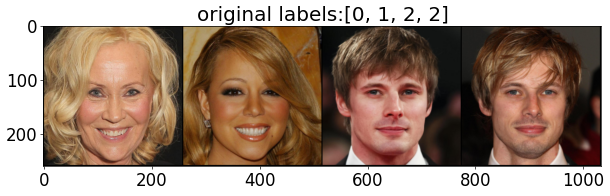

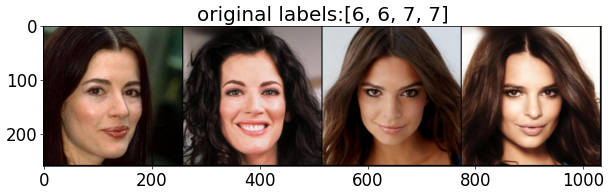

[Start Image Examples]


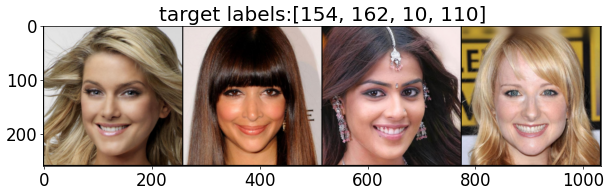

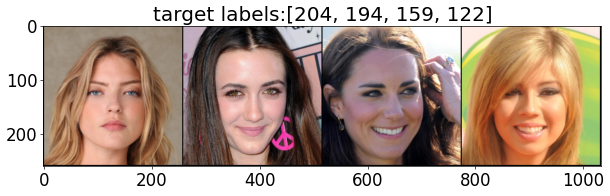

[Attack Result Examples]


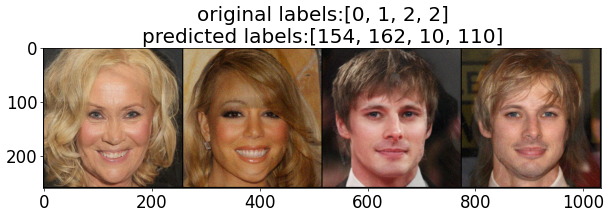

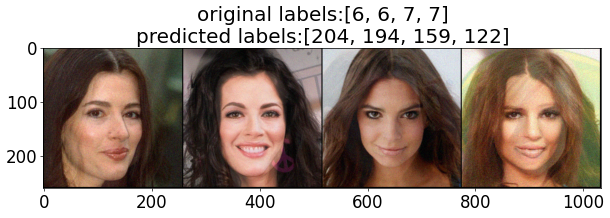

[Step #0] Loss: 0.3397 Accuracy: 0.0000% Attack success rate: 100.0000% Time elapsed: 66.9034s (total 8 images)
[Size of Perturbation]
Average L0 distance (the number of changed parameters): 196571.625
Average L2 distance: 35.93280029296875
Average MSE (from Start): 0.06381410360336304
Average MSE: 0.008114087395370007
Average Linf distance (the maximum changed values): 0.2942398488521576
[Attack start for one batch]
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.4551, 0.6575, 0.7308, 0.6161, 0.4631, 0.6088, 0.5074, 0.7934],
                     device='cuda:0'))
Binary step count: 27
Gradient step count: 100
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.9013, 0.9137, 0.9601, 0.8814, 0.8715, 0.9156, 0.9617, 0.9944],
                     device='cuda:0'))
Binary step count: 26
Gradient step count: 141
Reached numerical precision!
Binary step ratio (up to 8 examples): PyTorchTensor(tensor([0.9192, 0.

In [ ]:
%autoreload 2

import time
from foolbox import criteria
import foolbox as fb

criterion = nn.CrossEntropyLoss()
model.eval()
start_time = time.time()

fmodel = fb.PyTorchModel(model, bounds=(0, 1))
attack = fb.attacks.HopSkipJump(init_attack=None, steps=100,
                                # initial_gradient_eval_steps=100, max_gradient_eval_steps=10000,
                                query_limit=5000)

running_loss = 0.
running_corrects = 0
running_success = 0
running_length = 0

running_l0 = 0
running_l2 = 0
running_mse = 0
running_mse_from_start = 0
running_linf = 0

for i, (inputs, npys, labels, target_inputs, target_npys, target_labels) in enumerate(test_dataloader):
    inputs = inputs.to(device)
    labels = labels.to(device)

    starting_points = target_inputs.to(device)
    target_labels = target_labels.to(device)

    attack_criterion = criteria.TargetedMisclassification(target_labels)
    _, adv_targeted, _ = attack(fmodel, inputs, criterion=attack_criterion, starting_points=starting_points, epsilons=None) # adversarial attack

    outputs = model(adv_targeted)
    _, preds = torch.max(outputs, 1)
    loss = criterion(outputs, labels)

    running_loss += loss.item()
    running_corrects += torch.sum(preds == labels.data)
    running_success += torch.sum(preds == target_labels.data)
    running_length += labels.shape[0]

    l0, l2, mse, linf = get_distance(adv_targeted, inputs)
    running_l0 += l0.sum().item()
    running_l2 += l2.sum().item()
    running_mse += mse.sum().item()
    running_mse_from_start += (adv_targeted - starting_points).view(adv_targeted.shape[0], -1).pow(2).mean(1).sum().item()
    running_linf += linf.sum().item()

    if i == 0:
        print('The dimension of an image tensor:', inputs.shape[1:])
        print('[Original Image Examples]')
        images = torchvision.utils.make_grid(inputs[:4])
        imshow(images.cpu(), title='original labels:' + str([int(x) for x in labels[:4]]))
        images = torchvision.utils.make_grid(inputs[4:8])
        imshow(images.cpu(), title='original labels:' + str([int(x) for x in labels[4:8]]))
        print('[Start Image Examples]')
        images = torchvision.utils.make_grid(starting_points[:4])
        imshow(images.cpu(), title='target labels:' + str([int(x) for x in target_labels[:4]]))
        images = torchvision.utils.make_grid(starting_points[4:8])
        imshow(images.cpu(), title='target labels:' + str([int(x) for x in target_labels[4:8]]))
        print('[Attack Result Examples]')
        images = torchvision.utils.make_grid(adv_targeted[:4])
        imshow(images.cpu(), title='original labels:' + str([int(x) for x in labels[:4]]) +
               '\npredicted labels:' + str([int(x) for x in preds[:4]]))
        images = torchvision.utils.make_grid(adv_targeted[4:8])
        imshow(images.cpu(), title='original labels:' + str([int(x) for x in labels[4:8]]) +
               '\npredicted labels:' + str([int(x) for x in preds[4:8]]))

    cur_running_loss = running_loss / running_length
    running_acc = running_corrects / running_length * 100.
    running_asr = running_success / running_length * 100.
    print('[Step #{}] Loss: {:.4f} Accuracy: {:.4f}% Attack success rate: {:.4f}% Time elapsed: {:.4f}s (total {} images)'.format(i, cur_running_loss, running_acc, running_asr, time.time() - start_time, running_length))

    print('[Size of Perturbation]')
    print('Average L0 distance (the number of changed parameters):', running_l0 / running_length)
    print('Average L2 distance:', running_l2 / running_length)
    print('Average MSE (from Start):', running_mse_from_start / running_length)
    print('Average MSE:', running_mse / running_length)
    print('Average Linf distance (the maximum changed values):', running_linf / running_length)

epoch_loss = running_loss / running_length
epoch_acc = running_corrects / running_length * 100.
epoch_asr = running_success / running_length * 100.
print('[Validation] Loss: {:.4f} Accuracy: {:.4f}% Attack success rate: {:.4f}% Time elapsed: {:.4f}s (total {} images)'.format(epoch_loss, epoch_acc, epoch_asr, time.time() - start_time, running_length))

print('[Size of Perturbation]')
print('Average L0 distance (the number of changed parameters):', running_l0 / running_length)
print('Average L2 distance:', running_l2 / running_length)
print('Average MSE (from Start):', running_mse_from_start / running_length)
print('Average MSE:', running_mse / running_length)
print('Average Linf distance (the maximum changed values):', running_linf / running_length)